NaN values found in 'edges' DataFrame:
Column: vi Room Name, Rows: [2800, 2801, 2802, 2803, 2804, 2805, 2806, 2807, 2808, 2809, 2810, 2811, 2812, 2813, 2814, 2815, 2816, 2817, 2818, 2819, 2820, 2821, 2822, 2823]
Column: vj Room Name, Rows: [31, 2800, 2801, 2802, 2803, 2804, 2805, 2806, 2807, 2808, 2809, 2810, 2811, 2812, 2813, 2814, 2815, 2816, 2817, 2818, 2819, 2820, 2821, 2822, 2823]
Column: Wall Unique ID, Rows: [1624, 1625, 1626, 1627, 1628, 1629, 1630, 1631, 1632, 1633, 1634, 1635, 1636, 1637, 1638, 1639, 1640, 1641, 1642, 1643, 1644, 1645, 1646, 1647, 1648, 1649, 1650, 1651, 1652, 1653, 1654, 1655, 1656, 1657, 1658, 1659, 1660, 1661, 1662, 1663, 1664, 1665, 1666, 1667, 1668, 1669, 1670, 1671, 1672, 1673, 1674, 1675, 1676, 1677, 1678, 1679, 1680, 1681, 1682, 1683, 1684, 1685, 1686, 1687, 1688, 1689, 1690, 1691, 1692, 1693, 1694, 1695, 1696, 1697, 1698, 1699, 1700, 1701, 1702, 1703, 1704, 1705, 1706, 1707, 1708, 1709, 1710, 1711, 1712, 1713, 1714, 1715, 1716, 1717, 1718, 1719, 1720

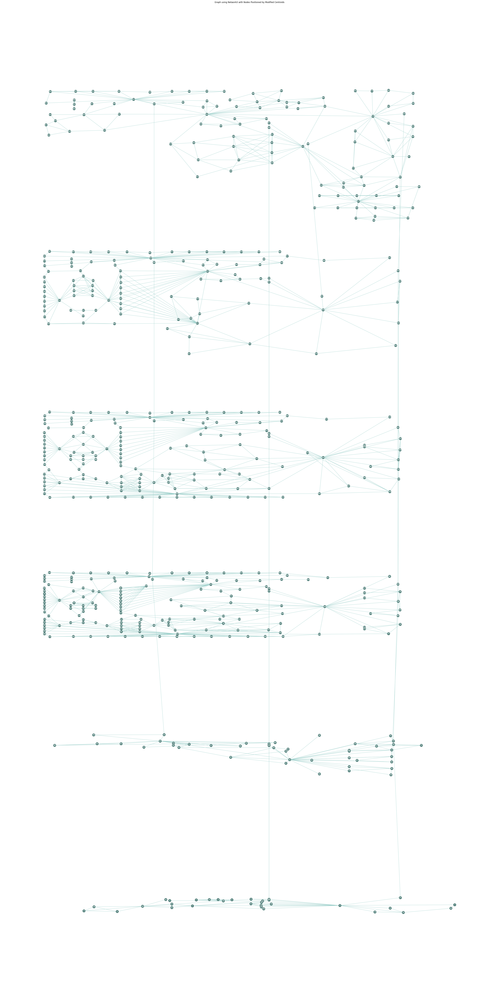

In [1]:
import csv
import os
import networkx as nx
import matplotlib.pyplot as plt
import pandas as pd
import ast  # For string-to-tuple conversion

# Aesthetics
cmap = plt.cm.jet
cmap = cmap.reversed()
cmap.set_bad('gray')

font_family = 'sans serif'
font_weight = 'bold'
font_size = '8'
edge_color = '#9BCFCA'
font_color = 'white'
node_col = '#55827D'

highlight = '#E10686'
figsize = (30, 30)
figsize_B = (40, 80)

# File Paths
directory = r"C:\Users\Georgios Bekakos\Desktop"
nodes_csv = os.path.join(directory, "nodes_final.csv")
hor_edges_csv = os.path.join(directory, "edges_final.csv")
vert_edges_csv = os.path.join(directory, "edges_vertical_final.csv")

# Read CSVs
nodes = pd.read_csv(nodes_csv)
hor_edges = pd.read_csv(hor_edges_csv)
vert_edges = pd.read_csv(vert_edges_csv)

# Rename Columns for Vertical Edges
new_column_names = {
    'Source Room Number': 'vi Room Number',
    'Target Room Number': 'vj Room Number',
    'Source Room Unique ID': 'vi Room Unique ID',
    'Target Room Unique ID': 'vj Room Unique ID'
}
vert_edges.rename(columns=new_column_names, inplace=True)
# Debugging Steps


# Concatenate Edges
edges = pd.concat([hor_edges, vert_edges], ignore_index=True)

# Extract a list of levels to use as multipliers for Y coordinates
multipliers_A = list(nodes['Level'])

# Single value for multiplication
scale = 0.1
# Multiply each integer by the multiplier
multipliers = [x * scale for x in multipliers_A]

# Convert the list of strings to a list of tuples
coordinates_strings = list(nodes['Centroid'])
coordinates_tuples = [(float(x), float(y)) for x, y in [coord.strip('()').split(',') for coord in coordinates_strings]]

# Multiply the y values by the corresponding multipliers
modified_coordinates = [(x, y * multiplier) for (x, y), multiplier in zip(coordinates_tuples, multipliers)]

# Create position dictionary based on the modified centroids
pos = {row['Index']: modified_coordinates[i] for i, (_, row) in enumerate(nodes.iterrows())}

# Create Graph from Edges and Embed Edge Info
G = nx.Graph()
for _, row in edges.iterrows():
    source = row['vi']
    target = row['vj']
    edge_attributes = row.drop(['vi', 'vj']).fillna('None').to_dict()
    G.add_edge(source, target, **edge_attributes)

# Embed Node Info
node_attributes = {}
for _, row in nodes.iterrows():
    node_id = row['Index']
    node_attributes[node_id] = row.fillna('None').to_dict()
nx.set_node_attributes(G, node_attributes)


# Step 1: Check for NaNs in DataFrames
if nodes.isnull().values.any() or edges.isnull().values.any():
    print("Warning: NaN values found in DataFrames.")
    if nodes.isnull().values.any():
        print("NaN values found in 'nodes' DataFrame:")
        for column in nodes.columns:
            nan_rows = nodes[nodes[column].isna()].index.tolist()
            if nan_rows:
                print(f"Column: {column}, Rows: {nan_rows}")
    if edges.isnull().values.any():
        print("NaN values found in 'edges' DataFrame:")
        for column in edges.columns:
            nan_rows = edges[edges[column].isna()].index.tolist()
            if nan_rows:
                print(f"Column: {column}, Rows: {nan_rows}")

# Existing Plotting Code
# ...


# Plotting
plt.figure(figsize=figsize_B)
nx.draw(G, pos, with_labels=True, node_color=node_col, font_family=font_family,
        font_weight=font_weight, font_size=font_size, edge_color=edge_color, font_color=font_color, node_size=250)
plt.title("Graph using NetworkX with Nodes Positioned by Modified Centroids")
plt.show()


# # slow

In [81]:
import csv
import os
import networkx as nx
import matplotlib.pyplot as plt
import pandas as pd
import ast

# Aesthetics
cmap = plt.cm.jet
cmap = cmap.reversed()
cmap.set_bad('gray')

font_family = 'sans serif'
font_weight = 'bold'
font_size = '8'
edge_color = '#ADD8E6' #light
font_color = 'white'
node_col2 = '#6495ED'  #mid
node_col = '#4682B4' #dark

highlight = '#E10686'
figsize = (30, 30)
figsize_B = (40, 80)

# File Paths
directory = r"C:\Users\Georgios Bekakos\Desktop"
nodes_csv = os.path.join(directory, "nodes_final.csv")
hor_edges_csv = os.path.join(directory, "edges_final.csv")
vert_edges_csv = os.path.join(directory, "edges_vertical_final.csv")

# Read CSVs
nodes = pd.read_csv(nodes_csv)
hor_edges = pd.read_csv(hor_edges_csv)
vert_edges = pd.read_csv(vert_edges_csv)

# Rename Columns for Vertical Edges
new_column_names = {
    'Source Room Number': 'vi Room Number',
    'Target Room Number': 'vj Room Number',
    'Source Room Unique ID': 'vi Room Unique ID',
    'Target Room Unique ID': 'vj Room Unique ID'
}
vert_edges.rename(columns=new_column_names, inplace=True)

# Concatenate Edges
edges = pd.concat([hor_edges, vert_edges], ignore_index=True)

# Create Position Dictionary
multipliers_A = list(nodes['Level'])
scale = 0.1
multipliers = [x * scale for x in multipliers_A]

coordinates_strings = list(nodes['Centroid'])
coordinates_tuples = [(float(x), float(y)) for x, y in [coord.strip('()').split(',') for coord in coordinates_strings]]

modified_coordinates = [(x, y * multiplier) for (x, y), multiplier in zip(coordinates_tuples, multipliers)]
pos = {row['Index']: modified_coordinates[i] for i, (_, row) in enumerate(nodes.iterrows())}

# Create Graph and Embed Edge and Node Info
G = nx.Graph()
for _, row in edges.iterrows():
    source = row['vi']
    target = row['vj']
    edge_attributes = row.drop(['vi', 'vj']).fillna('None').to_dict()
    G.add_edge(source, target, **edge_attributes)

node_attributes = {}
for _, row in nodes.iterrows():
    node_id = row['Index']
    node_attributes[node_id] = row.fillna('None').to_dict()
nx.set_node_attributes(G, node_attributes)

# Continue from where you left off:

# ... (Your existing code to import modules, read data, and create graphs remains unchanged)

# Input and constraints
input_amplifiers = [0, 2, 5, 1]
entrance_node = 0

# Step 1: Initialize the coherent network with the entrance node
G_coherent = nx.Graph()
G_coherent.add_node(entrance_node)

# Keep track of nodes that need to be connected to the coherent network
remaining_nodes = set(n for n, attr in G.nodes(data=True) if attr['Program Amplifier'] in input_amplifiers)

# Function to add closest node from 'remaining_nodes' to 'G_coherent'
def add_closest_node_to_coherent(G, G_coherent, remaining_nodes):
    shortest_distance = float('inf')
    closest_node = None
    start_node = None
    
    for node in G_coherent.nodes():
        for target in remaining_nodes:
            try:
                distance = nx.shortest_path_length(G, source=node, target=target, weight='Connecting Centroids Distance')
                if distance < shortest_distance:
                    shortest_distance = distance
                    closest_node = target
                    start_node = node
            except nx.NetworkXNoPath:
                continue
    
    if closest_node is not None:
        path = nx.shortest_path(G, source=start_node, target=closest_node, weight='Connecting Centroids Distance')
        for i in range(len(path) - 1):
            G_coherent.add_edge(path[i], path[i + 1])
        remaining_nodes.remove(closest_node)

# Step 2-5: Loop until all nodes with specified Program Amplifiers are part of the coherent network
while remaining_nodes:
    add_closest_node_to_coherent(G, G_coherent, remaining_nodes)

# Initialize a list to store node colors
node_colors = []

# Initialize a list to store node colors
node_colors = []

# Update node sizes and create node colors list
node_sizes = []
for node in G.nodes():
    if node in G_coherent.nodes:
        size = 1200 * nodes.loc[nodes['Index'] == node, 'Circulation Index'].iloc[0]
        color = node_col  # Use node_col1 for nodes in coherent graph
    else:
        size = 250
        color = node_col2  # Use node_col2 for other nodes
    
    node_sizes.append(size)
    node_colors.append(color)

# Plotting
plt.figure(figsize=(40, 80))
nx.draw(G, pos, with_labels=True, node_size=node_sizes, width=edge_widths,
        font_family=font_family, font_size=font_size, font_weight=font_weight, font_color=font_color,
        node_color=node_colors, edge_color=edge_color)  # Now use node_colors for node_color

plt.title("Coherent Network with Nodes and Edges of Interest Highlighted")
plt.show()


KeyboardInterrupt: 

# # FAST

In [83]:
import csv
import os
import networkx as nx
import matplotlib.pyplot as plt
import pandas as pd
import ast

# Aesthetics
cmap = plt.cm.jet
cmap = cmap.reversed()
cmap.set_bad('gray')

font_family = 'sans serif'
font_weight = 'bold'
font_size = '8'
edge_color = '#9BCFCA'
font_color = 'white'
node_col = '#55827D'

highlight = '#E10686'
figsize = (30, 30)
figsize_B = (40, 80)

# File Paths
directory = r"C:\Users\Georgios Bekakos\Desktop"
nodes_csv = os.path.join(directory, "nodes_final.csv")
hor_edges_csv = os.path.join(directory, "edges_final.csv")
vert_edges_csv = os.path.join(directory, "edges_vertical_final.csv")

# Read CSVs
nodes = pd.read_csv(nodes_csv)
hor_edges = pd.read_csv(hor_edges_csv)
vert_edges = pd.read_csv(vert_edges_csv)

# Rename Columns for Vertical Edges
new_column_names = {
    'Source Room Number': 'vi Room Number',
    'Target Room Number': 'vj Room Number',
    'Source Room Unique ID': 'vi Room Unique ID',
    'Target Room Unique ID': 'vj Room Unique ID'
}
vert_edges.rename(columns=new_column_names, inplace=True)

# Concatenate Edges
edges = pd.concat([hor_edges, vert_edges], ignore_index=True)

# Create Position Dictionary
multipliers_A = list(nodes['Level'])
scale = 0.1
multipliers = [x * scale for x in multipliers_A]

coordinates_strings = list(nodes['Centroid'])
coordinates_tuples = [(float(x), float(y)) for x, y in [coord.strip('()').split(',') for coord in coordinates_strings]]

modified_coordinates = [(x, y * multiplier) for (x, y), multiplier in zip(coordinates_tuples, multipliers)]
pos = {row['Index']: modified_coordinates[i] for i, (_, row) in enumerate(nodes.iterrows())}

# Create Graph and Embed Edge and Node Info
G = nx.Graph()
always_include_nodes = set()  # Nodes to be always included (from vertical edges)

for idx, row in edges.iterrows():
    source = row['vi']
    target = row['vj']
    
    # Determine if the edge is from the vertical edges CSV
    is_vertical_edge = idx >= len(hor_edges)
    
    # Always include nodes connected by vertical edges
    if is_vertical_edge:
        always_include_nodes.add(source)
        always_include_nodes.add(target)

    # Only consider edges with Access = 1 or if they are from the vertical edges CSV
    if row['Access'] == 1 or is_vertical_edge:
        edge_attributes = row.drop(['vi', 'vj']).fillna('None').to_dict()
        G.add_edge(source, target, **edge_attributes)

# Always include nodes connected by vertical edges to the set of remaining nodes
remaining_nodes = set(n for n, attr in G.nodes(data=True) if 'Program Amplifier' in attr and attr['Program Amplifier'] in input_amplifiers)
remaining_nodes |= always_include_nodes

# Your existing code for setting node attributes remains unchanged
node_attributes = {}
for _, row in nodes.iterrows():
    node_id = row['Index']
    node_attributes[node_id] = row.fillna('None').to_dict()
nx.set_node_attributes(G, node_attributes)

# Always include nodes connected by vertical edges to the set of remaining nodes
remaining_nodes = (set(n for n, attr in G.nodes(data=True) if attr['Program Amplifier'] in input_amplifiers) 
                   | always_include_nodes)

# ... (Your existing code to import modules, read data, and create graphs remains unchanged)

# Function to merge clusters and add paths to coherent graph
def merge_clusters_and_add_to_coherent(G, G_coherent, clusters, closest_pairs):
    new_clusters = []
    for cluster, closest_node, start_node in closest_pairs:
        # Find which cluster closest_node belongs to
        belonging_cluster = next(c for c in clusters if closest_node in c)
        
        # Merge the two clusters
        new_cluster = cluster.union(belonging_cluster)
        
        # Remove old clusters from the list and append the new merged cluster
        if cluster in clusters: clusters.remove(cluster)
        if belonging_cluster in clusters: clusters.remove(belonging_cluster)
        
        clusters.append(new_cluster)

        # Add the shortest path to G_coherent
        path = nx.shortest_path(G, source=start_node, target=closest_node, weight='Connecting Centroids Distance')
        for i in range(len(path) - 1):
            G_coherent.add_edge(path[i], path[i + 1])
# Input and constraints
input_amplifiers = [1, 2, 3, 4, 5]
entrance_node = 0

# Step 1: Initialize the coherent network with the entrance node
G_coherent = nx.Graph()
G_coherent.add_node(entrance_node)

# Keep track of nodes that need to be connected to the coherent network
remaining_nodes = set(n for n, attr in G.nodes(data=True) if attr['Program Amplifier'] in input_amplifiers)

# Initialize clusters with each node as a single-node cluster
clusters = [{node} for node in remaining_nodes | {entrance_node}]

# Step 2-5: Loop until all nodes are part of the coherent network or escape if not possible
iterations = 0  # Counter to avoid infinite loops
max_iterations = 3000  # Set a maximum number of iterations

while len(clusters) > 1 and iterations < max_iterations:
    closest_pairs = []

    for cluster in clusters:
        shortest_distance = float('inf')
        closest_node, start_node = None, None

        for node in cluster:
            for target in remaining_nodes - cluster:
                try:
                    distance = nx.shortest_path_length(G, source=node, target=target, weight='Connecting Centroids Distance')
                    if distance < shortest_distance:
                        shortest_distance = distance
                        closest_node = target
                        start_node = node
                except nx.NetworkXNoPath:
                    continue

        if closest_node is not None:
            closest_pairs.append((cluster, closest_node, start_node))

    # Merge clusters and add paths to coherent graph
    merge_clusters_and_add_to_coherent(G, G_coherent, clusters, closest_pairs)
    
    iterations += 1  # Increment the counter

# Check for escape condition
if iterations >= max_iterations:
    print("Reached the maximum number of iterations. Exiting.")

# Update node sizes and edge widths
node_sizes = []
for node in G.nodes():
    if node in G_coherent.nodes:
        size = 2000 * nodes.loc[nodes['Index'] == node, 'Circulation Index'].iloc[0]
    elif node in always_include_nodes:
        size = 1000  # Size for nodes connected by vertical edges
    else:
        size = 250
    node_sizes.append(size)

edge_widths = []
for edge in G.edges():
    if edge in G_coherent.edges():
        width = 12
    elif edge[0] in always_include_nodes and edge[1] in always_include_nodes:
        width = 10  # Width for vertical edges
    else:
        width = 2
    edge_widths.append(width)

# Plotting
plt.figure(figsize=(40, 80))
nx.draw(G, pos, with_labels=True, node_size=node_sizes, width=edge_widths,
        font_family=font_family, font_size=font_size, font_weight=font_weight, font_color=font_color,
        node_color=node_col, edge_color=edge_color)

plt.title("Coherent Network with Nodes and Edges of Interest Highlighted")
plt.show()


KeyboardInterrupt: 

# # FASTER

Reached the maximum number of iterations. Exiting.


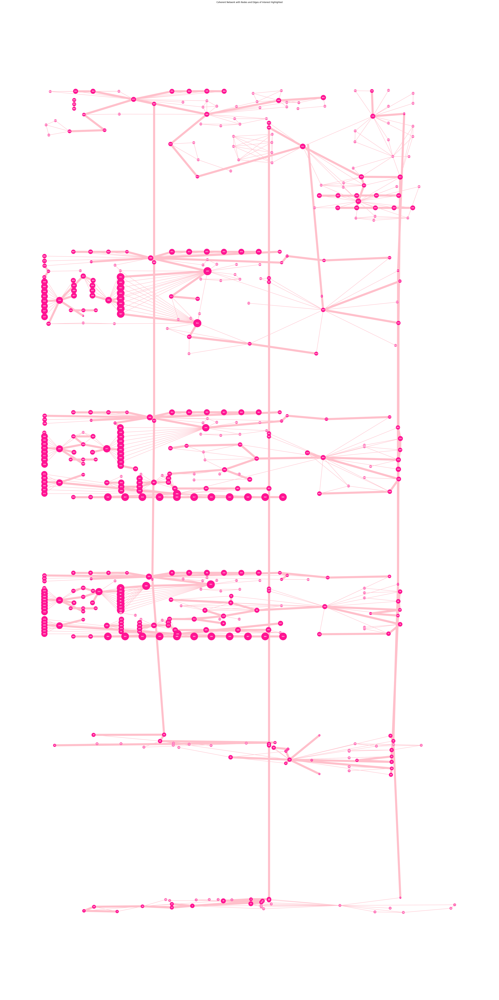

In [8]:
import csv
import os
import networkx as nx
import matplotlib.pyplot as plt
import pandas as pd
import ast

# Aesthetics
cmap = plt.cm.jet
cmap = cmap.reversed()
cmap.set_bad('gray')

font_family = 'sans serif'
font_weight = 'bold'
font_size = '8'
edge_color = '#FFC0CB' #light
font_color = 'white'
node_col2 = '#FF69B4'  #mid
node_col = '#FF1493' #dark


highlight = '#E10686'
figsize = (30, 30)
figsize_B = (40, 80)

# File Paths
directory = r"C:\Users\Georgios Bekakos\Desktop"
nodes_csv = os.path.join(directory, "nodes_final.csv")
hor_edges_csv = os.path.join(directory, "edges_final.csv")
vert_edges_csv = os.path.join(directory, "edges_vertical_final.csv")

# Read CSVs
nodes = pd.read_csv(nodes_csv)
hor_edges = pd.read_csv(hor_edges_csv)
vert_edges = pd.read_csv(vert_edges_csv)

# Rename Columns for Vertical Edges
new_column_names = {
    'Source Room Number': 'vi Room Number',
    'Target Room Number': 'vj Room Number',
    'Source Room Unique ID': 'vi Room Unique ID',
    'Target Room Unique ID': 'vj Room Unique ID'
}
vert_edges.rename(columns=new_column_names, inplace=True)

# Concatenate Edges
edges = pd.concat([hor_edges, vert_edges], ignore_index=True)

# Create Position Dictionary
multipliers_A = list(nodes['Level'])
scale = 0.1
multipliers = [x * scale for x in multipliers_A]


# Input and constraints
input_amplifiers = [3, 4, 5]
entrance_node = 0


coordinates_strings = list(nodes['Centroid'])
coordinates_tuples = [(float(x), float(y)) for x, y in [coord.strip('()').split(',') for coord in coordinates_strings]]

modified_coordinates = [(x, y * multiplier) for (x, y), multiplier in zip(coordinates_tuples, multipliers)]
pos = {row['Index']: modified_coordinates[i] for i, (_, row) in enumerate(nodes.iterrows())}

# Create Graph and Embed Edge and Node Info
G = nx.Graph()
always_include_nodes = set()  # Nodes to be always included (from vertical edges)

for idx, row in edges.iterrows():
    source = row['vi']
    target = row['vj']
    
    # Determine if the edge is from the vertical edges CSV
    is_vertical_edge = idx >= len(hor_edges)
    
    # Always include nodes connected by vertical edges
    if is_vertical_edge:
        always_include_nodes.add(source)
        always_include_nodes.add(target)

    # Only consider edges with Access = 1 or if they are from the vertical edges CSV
    if row['Access'] == 1 or is_vertical_edge:
        edge_attributes = row.drop(['vi', 'vj']).fillna('None').to_dict()
        G.add_edge(source, target, **edge_attributes)

# Always include nodes connected by vertical edges to the set of remaining nodes
remaining_nodes = set(n for n, attr in G.nodes(data=True) if 'Program Amplifier' in attr and attr['Program Amplifier'] in input_amplifiers)
remaining_nodes |= always_include_nodes

# Your existing code for setting node attributes remains unchanged
node_attributes = {}
for _, row in nodes.iterrows():
    node_id = row['Index']
    node_attributes[node_id] = row.fillna('None').to_dict()
nx.set_node_attributes(G, node_attributes)

# Always include nodes connected by vertical edges to the set of remaining nodes
remaining_nodes = (set(n for n, attr in G.nodes(data=True) if attr['Program Amplifier'] in input_amplifiers) 
                   | always_include_nodes)

# ... (Your existing code to import modules, read data, and create graphs remains unchanged)

# Function to merge clusters and add paths to coherent graph
def merge_clusters_and_add_to_coherent(G, G_coherent, clusters, closest_pairs):
    new_clusters = []
    for cluster, closest_node, start_node in closest_pairs:
        # Find which cluster closest_node belongs to
        belonging_cluster = next(c for c in clusters if closest_node in c)
        
        # Merge the two clusters
        new_cluster = cluster.union(belonging_cluster)
        
        # Remove old clusters from the list and append the new merged cluster
        if cluster in clusters: clusters.remove(cluster)
        if belonging_cluster in clusters: clusters.remove(belonging_cluster)
        
        clusters.append(new_cluster)

        # Add the shortest path to G_coherent
        path = nx.shortest_path(G, source=start_node, target=closest_node, weight='Connecting Centroids Distance')
        for i in range(len(path) - 1):
            G_coherent.add_edge(path[i], path[i + 1])


# Step 1: Initialize the coherent network with the entrance node
G_coherent = nx.Graph()
G_coherent.add_node(entrance_node)

# Keep track of nodes that need to be connected to the coherent network
remaining_nodes = set(n for n, attr in G.nodes(data=True) if attr['Program Amplifier'] in input_amplifiers)

# Initialize clusters with each node as a single-node cluster
clusters = [{node} for node in remaining_nodes | {entrance_node}]

# Pre-calculate shortest paths and their lengths for quicker access
shortest_paths = {}
shortest_path_lengths = {}
for source in G.nodes():
    shortest_paths[source] = nx.single_source_dijkstra_path(G, source=source, weight='Connecting Centroids Distance')
    shortest_path_lengths[source] = nx.single_source_dijkstra_path_length(G, source=source, weight='Connecting Centroids Distance')

# Initialize clusters with each node as a single-node cluster
clusters = [{node} for node in remaining_nodes | {entrance_node}]

# Initialize
iterations = 0
max_iterations = 20000

while len(clusters) > 1 and iterations < max_iterations:
    closest_pairs = []

    for cluster in clusters:
        shortest_distance = float('inf')
        closest_node, start_node = None, None

        for node in cluster:
            for target in remaining_nodes - cluster:
                try:
                    distance = shortest_path_lengths[node].get(target, float('inf'))
                    if distance < shortest_distance:
                        shortest_distance = distance
                        closest_node = target
                        start_node = node
                except KeyError:
                    continue

        if closest_node is not None:
            closest_pairs.append((cluster, closest_node, start_node))

    # Merge clusters and add paths to coherent graph
    merge_clusters_and_add_to_coherent(G, G_coherent, clusters, closest_pairs)
    
    iterations += 1

# Check for escape condition
if iterations >= max_iterations:
    print("Reached the maximum number of iterations. Exiting.")

# Initialize a list to store node colors
node_colors = []

# Initialize a list to store node colors
node_colors = []

# Update node sizes and create node colors list
node_sizes = []
for node in G.nodes():
    if node in G_coherent.nodes:
        size = 1200 * nodes.loc[nodes['Index'] == node, 'Circulation Index'].iloc[0]
        color = node_col  # Use node_col1 for nodes in coherent graph
    else:
        size = 250
        color = node_col2  # Use node_col2 for other nodes
    
    node_sizes.append(size)
    node_colors.append(color)

edge_widths = []
for edge in G.edges():
    if edge in G_coherent.edges():
        width = 12
    elif edge[0] in always_include_nodes and edge[1] in always_include_nodes:
        width = 10  # Width for vertical edges
    else:
        width = 2
    edge_widths.append(width)
# Plotting
plt.figure(figsize=(40, 80))
nx.draw(G, pos, with_labels=True, node_size=node_sizes, width=edge_widths,
        font_family=font_family, font_size=font_size, font_weight=font_weight, font_color=font_color,
        node_color=node_colors, edge_color=edge_color)  # Now use node_colors for node_color

plt.title("Coherent Network with Nodes and Edges of Interest Highlighted")
plt.show()


# # Minimum Spanning Tree

In [ ]:
import csv
import os
import networkx as nx
import matplotlib.pyplot as plt
import pandas as pd
import ast

# Aesthetics
cmap = plt.cm.jet
cmap = cmap.reversed()
cmap.set_bad('gray')
font_family = 'sans serif'
font_weight = 'bold'
font_size = '8'
edge_color = '#9BCFCA'
font_color = 'white'
node_col = '#55827D'
highlight = '#E10686'
figsize = (30, 30)
figsize_B = (40, 80)

# File Paths
directory = r"C:\Users\Georgios Bekakos\Desktop"
nodes_csv = os.path.join(directory, "nodes_final.csv")
hor_edges_csv = os.path.join(directory, "edges_final.csv")
vert_edges_csv = os.path.join(directory, "edges_vertical_final.csv")

# Read CSVs
nodes = pd.read_csv(nodes_csv)
hor_edges = pd.read_csv(hor_edges_csv)
vert_edges = pd.read_csv(vert_edges_csv)

# Rename Columns for Vertical Edges
new_column_names = {'Source Room Number': 'vi Room Number', 'Target Room Number': 'vj Room Number', 'Source Room Unique ID': 'vi Room Unique ID', 'Target Room Unique ID': 'vj Room Unique ID'}
vert_edges.rename(columns=new_column_names, inplace=True)

# Concatenate Edges
edges = pd.concat([hor_edges, vert_edges], ignore_index=True)

# Create Position Dictionary
multipliers_A = list(nodes['Level'])
scale = 0.1
multipliers = [x * scale for x in multipliers_A]

coordinates_strings = list(nodes['Centroid'])
coordinates_tuples = [(float(x), float(y)) for x, y in [coord.strip('()').split(',') for coord in coordinates_strings]]

modified_coordinates = [(x, y * multiplier) for (x, y), multiplier in zip(coordinates_tuples, multipliers)]
pos = {row['Index']: modified_coordinates[i] for i, (_, row) in enumerate(nodes.iterrows())}

# Create Graph and Embed Edge and Node Info
G = nx.Graph()

# Add edges based on your conditions
for idx, row in edges.iterrows():
    source = row['vi']
    target = row['vj']
    edge_attributes = row.drop(['vi', 'vj']).fillna('None').to_dict()
    G.add_edge(source, target, **edge_attributes)

# Add node attributes
node_attributes = {}
for _, row in nodes.iterrows():
    node_id = row['Index']
    node_attributes[node_id] = row.fillna('None').to_dict()
nx.set_node_attributes(G, node_attributes)

# Generate MST
MST = nx.minimum_spanning_tree(G, algorithm='kruskal', weight='Connecting Centroids Distance')

# Define Node and Edge styles for G
node_sizes = [800 for node in G.nodes]

edge_colors = ['#506b69' if edge in MST.edges() else edge_color for edge in G.edges]
edge_widths = [6 if edge in MST.edges() else 2 for edge in G.edges]

# Plotting
plt.figure(figsize=(40, 80))

# Draw original graph
nx.draw(G, pos, with_labels=True,
        node_color=node_col, node_size=node_sizes,
        edge_color=edge_colors, width=edge_widths,
        font_family=font_family, font_size=font_size, font_weight=font_weight, font_color=font_color)

plt.title("Coherent Network with MST Highlighted")
plt.show()


# # AGENTS

# # students

In [65]:
from mesa import Agent, Model
from mesa.time import RandomActivation
from mesa.datacollection import DataCollector
import networkx as nx
import random
import pandas as pd
from collections import Counter

# Copy G_coherent to G_sub and embed node and edge attributes from G
G_sub = G.copy()

# Initialize a Counter to store edge traversal counts
edge_counter = Counter()

class StudentAgent(Agent):
    def __init__(self, unique_id, model, start_node, allowed_nodes):
        super().__init__(unique_id, model)
        self.start_node = start_node
        self.current_node = start_node
        self.path = [start_node]
        self.allowed_nodes = allowed_nodes
        self.start_room_name = G_sub.nodes[start_node]['Room Name']
        self.room_name = self.start_room_name
        self.has_reached_destination = False  # Add this line
    def move(self):
        if self.has_reached_destination:  # Add this line
            return  # Add this line
        # Look for Program Amplifier 4 or "Auditorium"
        target_nodes = [n for n in self.allowed_nodes if G_sub.nodes[n]['Program Amplifier'] == 4 or G_sub.nodes[n]['Room Name'] == "AUDITORIUM"]
        # Filter out filled rooms
        open_nodes = [node for node in target_nodes if self.model.room_count[node] < 50]
        if not open_nodes:
            open_nodes = [n for n in self.allowed_nodes if G_sub.nodes[n]['Room Name'] == 'WS']

        shortest = nx.shortest_path(G_sub, source=self.current_node, target=random.choice(open_nodes), weight='Connecting Centroids Distance')
        self.model.room_count[self.current_node] -= 1
        self.current_node = shortest[-1]
        self.path.extend(shortest[1:])
        self.model.room_count[self.current_node] += 1
        self.room_name = G_sub.nodes[self.current_node]['Room Name']

        self.has_reached_destination = True  # Add this line
        
        # Update the edge_counter for each edge traversed
        for u, v in zip(shortest[:-1], shortest[1:]):
            edge_counter[(min(u, v), max(u, v))] += 1

class UniversityModel(Model):
    def __init__(self, N, initial_nodes, allowed_nodes):
        self.num_agents = N
        self.schedule = RandomActivation(self)
        self.room_count = {node: 0 for node in G_sub.nodes()}
        for i in range(self.num_agents):
            node = random.choices(initial_nodes, weights=[G_sub.nodes[n]['Area'] for n in initial_nodes])[0]
            agent = StudentAgent(i, self, node, allowed_nodes)
            self.schedule.add(agent)
            self.room_count[node] += 1

        agent_reporters = {"Starting Node": "start_node", "Starting Room Name": "start_room_name", "Current Node": "current_node", "Room Name": "room_name", "Path": "path"}
        self.datacollector = DataCollector(agent_reporters=agent_reporters)

    def step(self):
        for agent in self.schedule.agents:
            agent.move()  # Explicitly call the move function
        self.datacollector.collect(self)

# Initialize and run the model
initial_nodes = [n for n, d in G_sub.nodes(data=True) if d['Program Amplifier'] == 5]
allowed_nodes = [n for n, d in G_sub.nodes(data=True) if d['Program Amplifier'] in [1, 2, 3, 4, 5]]

model = UniversityModel(N=1000, initial_nodes=initial_nodes, allowed_nodes=allowed_nodes)

for i in range(1):  # Run for one tick to simulate phase 1
    model.step()

# Collect and save the data
agent_data = model.datacollector.get_agent_vars_dataframe().reset_index()
agent_data.rename(columns={"Step": "Phase"}, inplace=True)
agent_data.to_csv("C:\\Users\\Georgios Bekakos\\Desktop\\agent_data.csv", index=False)

# Save room occupancy
room_data = pd.DataFrame.from_dict(model.room_count, orient='index', columns=['Occupancy'])
room_data['Room Name'] = [G_sub.nodes[n]['Room Name'] for n in room_data.index]
room_data.reset_index(inplace=True)
room_data.rename(columns={"index": "Node"}, inplace=True)
room_data.to_csv("C:\\Users\\Georgios Bekakos\\Desktop\\room_data.csv", index=False)

# Save the most used edges to a CSV
most_used_edges_df = pd.DataFrame.from_records([(u, v, count) for (u, v), count in edge_counter.items()], columns=['vi', 'vj', 'Count'])
most_used_edges_df.sort_values('Count', ascending=False, inplace=True)
most_used_edges_df.to_csv("C:\\Users\\Georgios Bekakos\\Desktop\\most_used_edges.csv", index=False)

# # ACADEMIC

In [9]:
from mesa import Agent, Model
from mesa.time import RandomActivation
from mesa.datacollection import DataCollector
import networkx as nx
import random
import pandas as pd
from collections import Counter

G_sub = G.copy()

academic_edge_counter = Counter()

class AcademicAgent(Agent):
    def __init__(self, unique_id, model, start_node, allowed_nodes):
        super().__init__(unique_id, model)
        self.start_node = start_node
        self.current_node = start_node
        self.path = [start_node]
        self.allowed_nodes = allowed_nodes
        self.room_name = G_sub.nodes[start_node]['Room Name']
        self.has_reached_destination = False
    
    def move(self):
        if self.has_reached_destination:
            return
        
        while True:
            target_nodes = [n for n in self.allowed_nodes if G_sub.nodes[n]['Room Name'].startswith('LAB') and self.model.academic_room_count[n] < 4]
            
            if not target_nodes:
                df = pd.read_csv("C:\\Users\\Georgios Bekakos\\Desktop\\room_data.csv")
                student_rooms = df[df['Occupancy'] > 0]['Node'].tolist()
                target_nodes = [n for n in student_rooms if self.model.academic_room_count[n] < 3]
            
            if not target_nodes:
                target_nodes = [n for n in self.allowed_nodes if G_sub.nodes[n]['Program Amplifier'] == 3]
            
            try:
                shortest = nx.shortest_path(G_sub, source=self.current_node, target=random.choice(target_nodes), weight='Connecting Centroids Distance')
                break  # Break the loop if a path is found
            except nx.NetworkXNoPath:
                continue  # No path was found, try again
            
        self.model.academic_room_count[self.current_node] -= 1
        self.current_node = shortest[-1]
        self.path.extend(shortest[1:])
        self.model.academic_room_count[self.current_node] += 1
        self.room_name = G_sub.nodes[self.current_node]['Room Name']
        
        self.has_reached_destination = True
        
        for u, v in zip(shortest[:-1], shortest[1:]):
            academic_edge_counter[(min(u, v), max(u, v))] += 1

class AcademicUniversityModel(Model):
    def __init__(self, N, initial_nodes, allowed_nodes):
        self.num_agents = N
        self.schedule = RandomActivation(self)
        self.academic_room_count = {node: 0 for node in G_sub.nodes()}
        for i in range(self.num_agents):
            node = random.choices(initial_nodes, weights=[G_sub.nodes[n]['Area'] for n in initial_nodes])[0]
            agent = AcademicAgent(i, self, node, allowed_nodes)
            self.schedule.add(agent)
            self.academic_room_count[node] += 1

        agent_reporters = {"Starting Node": "start_node", "Starting Room Name": "room_name", "Current Node": "current_node", "Room Name": "room_name", "Path": "path"}
        self.datacollector = DataCollector(agent_reporters=agent_reporters)

    def step(self):
        for agent in self.schedule.agents:
            agent.move()
        self.datacollector.collect(self)

# Initialize and run the Academic model
initial_nodes = [n for n, d in G_sub.nodes(data=True) if d['Program Amplifier'] == 5]
allowed_nodes = [n for n, d in G_sub.nodes(data=True) if d['Program Amplifier'] in [1, 2, 3, 4, 5]]

academic_model = AcademicUniversityModel(N=400, initial_nodes=initial_nodes, allowed_nodes=allowed_nodes)

for i in range(1):  # Run for one tick to simulate phase 1
    academic_model.step()

# Save data similar to before but with 'academic_' prefix
academic_agent_data = academic_model.datacollector.get_agent_vars_dataframe().reset_index()
academic_agent_data.rename(columns={"Step": "Phase"}, inplace=True)
academic_agent_data.to_csv("C:\\Users\\Georgios Bekakos\\Desktop\\academic_agent_data.csv", index=False)

academic_room_data = pd.DataFrame.from_dict(academic_model.academic_room_count, orient='index', columns=['Occupancy'])
academic_room_data['Room Name'] = [G_sub.nodes[n]['Room Name'] for n in academic_room_data.index]
academic_room_data.reset_index(inplace=True)
academic_room_data.rename(columns={"index": "Node"}, inplace=True)
academic_room_data.to_csv("C:\\Users\\Georgios Bekakos\\Desktop\\academic_room_data.csv", index=False)

academic_most_used_edges_df = pd.DataFrame.from_records([(u, v, count) for (u, v), count in academic_edge_counter.items()], columns=['vi', 'vj', 'Count'])
academic_most_used_edges_df.sort_values('Count', ascending=False, inplace=True)
academic_most_used_edges_df.to_csv("C:\\Users\\Georgios Bekakos\\Desktop\\academic_most_used_edges.csv", index=False)


# # STAFF

In [20]:
from mesa import Agent, Model
from mesa.time import RandomActivation
from mesa.datacollection import DataCollector
import networkx as nx
import random
import pandas as pd
from collections import Counter

G_sub = G.copy()

staff_edge_counter = Counter()

class StaffAgent(Agent):
    def __init__(self, unique_id, model, start_node, allowed_nodes):
        super().__init__(unique_id, model)
        self.start_node = start_node
        self.current_node = start_node
        self.path = [start_node]
        self.allowed_nodes = allowed_nodes
        self.room_name = G_sub.nodes[start_node]['Room Name']
        self.has_reached_destination = False
    
    def move(self):
        if self.has_reached_destination:
            return

        while True:
            target_nodes = [n for n in self.allowed_nodes if G_sub.nodes[n]['Room Name'].startswith('STAFF OFFICE') and self.model.staff_room_count[n] < 2]
            
            if not target_nodes:
                target_nodes = [n for n in self.allowed_nodes if G_sub.nodes[n]['Program Amplifier'] in [0, 2]]
            
            try:
                shortest = nx.shortest_path(G_sub, source=self.current_node, target=random.choice(target_nodes), weight='Connecting Centroids Distance')
                break  # Break the loop if a path is found
            except nx.NetworkXNoPath:
                continue  # No path was found, try again

        self.model.staff_room_count[self.current_node] -= 1
        self.current_node = shortest[-1]
        self.path.extend(shortest[1:])
        self.model.staff_room_count[self.current_node] += 1
        self.room_name = G_sub.nodes[self.current_node]['Room Name']
        
        self.has_reached_destination = True
        
        for u, v in zip(shortest[:-1], shortest[1:]):
            staff_edge_counter[(min(u, v), max(u, v))] += 1

class StaffUniversityModel(Model):
    def __init__(self, N, initial_nodes, allowed_nodes):
        self.num_agents = N
        self.schedule = RandomActivation(self)
        self.staff_room_count = {node: 0 for node in G_sub.nodes()}
        for i in range(self.num_agents):
            node = random.choices(initial_nodes, weights=[G_sub.nodes[n]['Area'] for n in initial_nodes])[0]
            agent = StaffAgent(i, self, node, allowed_nodes)
            self.schedule.add(agent)
            self.staff_room_count[node] += 1

        agent_reporters = {"Starting Node": "start_node", "Starting Room Name": "room_name", "Current Node": "current_node", "Room Name": "room_name", "Path": "path"}
        self.datacollector = DataCollector(agent_reporters=agent_reporters)

    def step(self):
        for agent in self.schedule.agents:
            agent.move()
        self.datacollector.collect(self)
        print("Agent Records:", self.datacollector._agent_records)  # Debug print
# Initialize and run the Staff model
initial_nodes = [n for n, d in G_sub.nodes(data=True) if d['Program Amplifier'] == 5]
allowed_nodes = [n for n, d in G_sub.nodes(data=True) if d['Program Amplifier'] in [0, 2, 5]]

staff_model = StaffUniversityModel(N=300, initial_nodes=initial_nodes, allowed_nodes=allowed_nodes)

for i in range(1):  # Run for one tick to simulate phase 1
    staff_model.step()

# Save data similar to before but with 'staff_' prefix
staff_agent_data = staff_model.datacollector.get_agent_vars_dataframe().reset_index()
staff_agent_data.rename(columns={"Step": "Phase"}, inplace=True)
staff_agent_data.to_csv("C:\\Users\\Georgios Bekakos\\Desktop\\staff_agent_data.csv", index=False)

staff_room_data = pd.DataFrame.from_dict(staff_model.staff_room_count, orient='index', columns=['Occupancy'])
staff_room_data['Room Name'] = [G_sub.nodes[n]['Room Name'] for n in staff_room_data.index]
staff_room_data.reset_index(inplace=True)
staff_room_data.rename(columns={"index": "Node"}, inplace=True)
staff_room_data.to_csv("C:\\Users\\Georgios Bekakos\\Desktop\\staff_room_data.csv", index=False)

staff_most_used_edges_df = pd.DataFrame.from_records([(u, v, count) for (u, v), count in staff_edge_counter.items()], columns=['vi', 'vj', 'Count'])
staff_most_used_edges_df.sort_values('Count', ascending=False, inplace=True)
staff_most_used_edges_df.to_csv("C:\\Users\\Georgios Bekakos\\Desktop\\staff_most_used_edges.csv", index=False)



Agent Records: {0: [(0, 0, 53, 'TRASH+RE', 218, 'TRASH+RE', [53, 42, 181, 209, 84, 218]), (0, 1, 488, 'EQUIPMENT', 24, 'EQUIPMENT', [488, 489, 433, 461, 501, 441, 302, 179, 44, 17, 26, 20, 19, 24]), (0, 2, 611, 'JAN', 225, 'JAN', [611, 568, 441, 302, 179, 209, 81, 225]), (0, 3, 53, 'ELECT', 508, 'ELECT', [53, 42, 181, 304, 440, 509, 416, 418, 508]), (0, 4, 180, 'EQUIP.', 520, 'EQUIP.', [180, 303, 442, 509, 416, 418, 508, 520]), (0, 5, 35, 'SIM: MS', 546, 'SIM: MS', [35, 53, 43, 180, 303, 442, 599, 579, 546]), (0, 6, 69, 'SP CONTROL', 575, 'SP CONTROL', [69, 53, 42, 181, 304, 440, 592, 577, 575]), (0, 7, 493, 'TRASH+RE', 389, 'TRASH+RE', [493, 509, 440, 304, 394, 255, 389]), (0, 8, 234, 'ASSOC. DEAN', 553, 'ASSOC. DEAN', [234, 112, 178, 214, 202, 201, 210, 206, 373, 488, 593, 613, 553]), (0, 9, 209, 'AV CLO.', 388, 'AV CLO.', [209, 181, 304, 253, 408, 388]), (0, 10, 229, 'DEBRIEF / PREBRIEF (SP open)', 574, 'DEBRIEF / PREBRIEF (SP open)', [229, 84, 209, 181, 304, 440, 592, 577, 574]), (

# # PLOTS

# TARGET

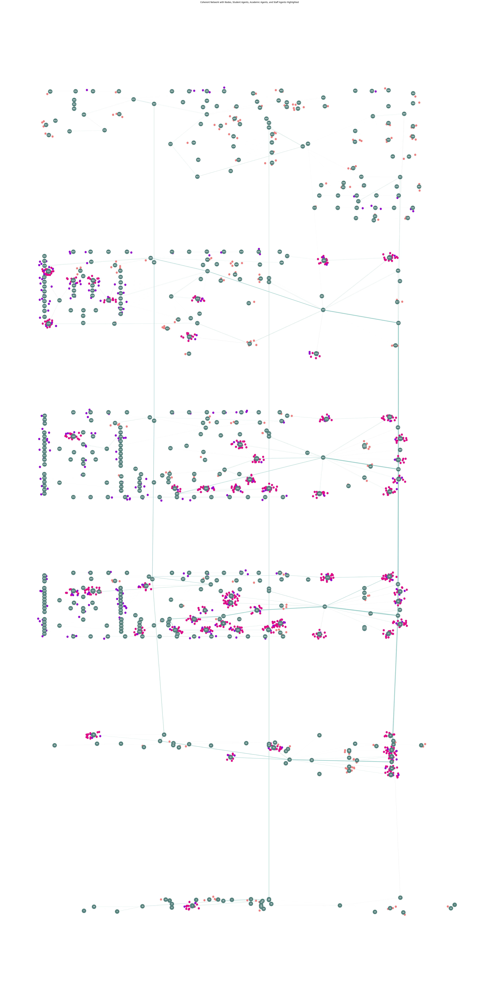

In [13]:
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np
from matplotlib.patches import Ellipse
import networkx as nx  # Assuming you're using networkx for your graph G_sub

# Read academic room data from CSV
academic_df = pd.read_csv('C:\\Users\\Georgios Bekakos\\Desktop\\academic_room_data.csv')
academic_room_count = academic_df.set_index('Node')['Occupancy'].to_dict()

# Read staff room data from CSV
staff_df = pd.read_csv('C:\\Users\\Georgios Bekakos\\Desktop\\staff_room_data.csv')
staff_room_count = staff_df.set_index('Node')['Occupancy'].to_dict()

# Aesthetics
font_family = 'sans serif'
font_weight = 'bold'
font_size = '8'
edge_color = '#9BCFCA'
font_color = 'white'
node_col = '#55827D'
student_agent_col = '#E10686'
academic_agent_col = 'darkviolet'
staff_agent_col = 'lightcoral'  # Color for staff

# Assuming G_sub and pos are defined, and edge_counter is a counter for edge weights
edge_widths = [edge_counter.get((min(u, v), max(u, v)), 1) / 50 for u, v in G_sub.edges()]

# Assuming model.room_count is a dictionary containing agent counts
node_sizes = {node: 600 + (model.room_count.get(node, 0) * 12) for node in G_sub.nodes()}

plt.figure(figsize=(40, 80))

nx.draw(G_sub, pos, with_labels=True,
        node_size=[node_sizes.get(node, 600) for node in G_sub.nodes()],
        node_color=node_col,
        width=edge_widths, edge_color=edge_color,
        font_family=font_family, font_size=font_size, font_weight=font_weight, font_color=font_color)

# Function to populate agent circles
def plot_agents(room_count, agent_col):
    for node, agents in room_count.items():
        if agents > 0:
            agent_radius = 1.4
            node_radius = np.sqrt(node_sizes.get(node, 600) / np.pi)
            center_x, center_y = pos[node]

            for _ in range(agents):
                angle = np.random.uniform(0, 2 * np.pi)
                r = np.random.uniform(0, 0.3 * node_radius)
                agent_x = center_x + r * np.cos(angle)
                agent_y = center_y + r * np.sin(angle)

                ellipse = Ellipse((agent_x, agent_y), width=agent_radius/1.2, height=agent_radius*1.6, facecolor=agent_col, edgecolor=None)
                plt.gca().add_artist(ellipse)

# Plot student agents
plot_agents(model.room_count, student_agent_col)

# Plot academic agents
plot_agents(academic_room_count, academic_agent_col)

# Plot staff agents
plot_agents(staff_room_count, staff_agent_col)

plt.title("Coherent Network with Nodes, Student Agents, Academic Agents, and Staff Agents Highlighted")
plt.gca().set_aspect('auto', adjustable='box')

plt.show()


In [27]:
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np
from matplotlib.patches import Ellipse
import networkx as nx  # Assuming you're using networkx for your graph G_sub

# Read edge usage data from CSV
academic_edges_df = pd.read_csv('C:\\Users\\Georgios Bekakos\\Desktop\\agent data phase 01\\academic_most_used_edges.csv')
staff_edges_df = pd.read_csv('C:\\Users\\Georgios Bekakos\\Desktop\\agent data phase 01\\staff_most_used_edges.csv')
student_edges_df = pd.read_csv('C:\\Users\\Georgios Bekakos\\Desktop\\agent data phase 01\\most_used_edges.csv')

# Aesthetics
font_family = 'sans serif'
font_weight = 'bold'
font_size = '8'
edge_color = '#9BCFCA'
font_color = 'white'
node_col = '#55827D'
student_agent_col = 'fuchsia'
academic_agent_col = 'orange'
staff_agent_col = 'darkslateblue'  # Color for staff

# Assuming G_sub and pos are defined, and edge_counter is a counter for edge weights
edge_widths = [edge_counter.get((min(u, v), max(u, v)), 1) / 50 for u, v in G_sub.edges()]

# Assuming model.room_count is a dictionary containing agent counts
node_sizes = {node: 600 + (model.room_count.get(node, 0) * 12) for node in G_sub.nodes()}

plt.figure(figsize=(40, 80))

nx.draw(G_sub, pos, with_labels=True,
        node_size=[node_sizes.get(node, 600) for node in G_sub.nodes()],
        node_color=node_col,
        width=edge_widths, edge_color=edge_color,
        font_family=font_family, font_size=font_size, font_weight=font_weight, font_color=font_color)

# Function to populate agent circles
def plot_agents(room_count, agent_col):
    for node, agents in room_count.items():
        if agents > 0:
            agent_radius = 1.4
            node_radius = np.sqrt(node_sizes.get(node, 600) / np.pi)
            center_x, center_y = pos[node]

            for _ in range(agents):
                angle = np.random.uniform(0, 2 * np.pi)
                r = np.random.uniform(0, 0.3 * node_radius)
                agent_x = center_x + r * np.cos(angle)
                agent_y = center_y + r * np.sin(angle)

                ellipse = Ellipse((agent_x, agent_y), width=agent_radius/1.2, height=agent_radius*1.6, facecolor=agent_col, edgecolor=None)
                plt.gca().add_artist(ellipse)
    print(f"Total number of agent dots plotted: {agent_dot_counter}")  # Display the final count
# Plot student agents
plot_agents(model.room_count, student_agent_col)

# Plot academic agents
plot_agents(academic_room_count, academic_agent_col)

# Plot staff agents
plot_agents(staff_room_count, staff_agent_col)

plt.title("Coherent Network with Nodes, Student Agents, Academic Agents, and Staff Agents Highlighted")
plt.gca().set_aspect('auto', adjustable='box')

plt.show()


NameError: name 'edge_counter' is not defined

SOURCE

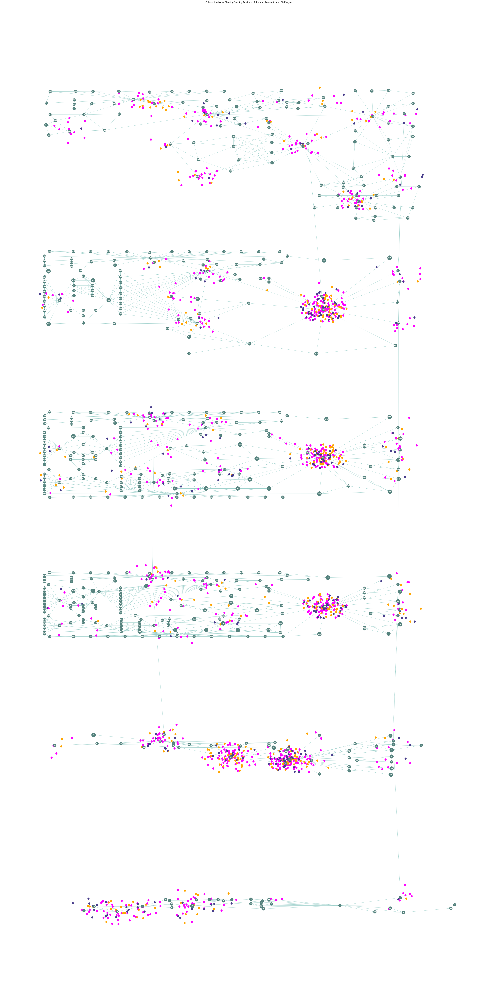

In [12]:
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np
from matplotlib.patches import Ellipse
import networkx as nx  # Assuming you're using networkx for your graph G_sub

# Read academic room data from CSV
academic_df = pd.read_csv('C:\\Users\\Georgios Bekakos\\Desktop\\agent data phase 01\\academic_agent_data.csv')
academic_starting_count = academic_df['Starting Node'].value_counts().to_dict()

# Read staff room data from CSV
staff_df = pd.read_csv('C:\\Users\\Georgios Bekakos\Desktop\\agent data phase 01\\staff_agent_data.csv')
staff_starting_count = staff_df['Starting Node'].value_counts().to_dict()

# Read student room data from CSV
student_df = pd.read_csv('C:\\Users\\Georgios Bekakos\\Desktop\\agent data phase 01\\agent_data.csv')
student_starting_count = student_df['Starting Node'].value_counts().to_dict()

# Aesthetics
font_family = 'sans serif'
font_weight = 'bold'
font_size = '8'
edge_color = '#9BCFCA'
font_color = 'white'
node_col = '#55827D'
student_agent_col = 'fuchsia'
academic_agent_col = 'orange'
staff_agent_col = 'darkslateblue'  # Color for staff

# Hardcode uniform edge width
uniform_edge_width = 0.7

# Assuming model.room_count is a dictionary containing agent counts
node_sizes = {node: 300 + (model.room_count.get(node, 0) * 12) for node in G_sub.nodes()}

plt.figure(figsize=(40, 80))

nx.draw(G_sub, pos, with_labels=True,
        node_size=[node_sizes.get(node, 600) for node in G_sub.nodes()],
        node_color=node_col,
        width=uniform_edge_width,  # Use the hardcoded uniform edge width here
        edge_color=edge_color,
        font_family=font_family, font_size=font_size, font_weight=font_weight, font_color=font_color)

# Function to populate agent circles based on starting nodes
def plot_starting_agents(starting_count, agent_col):
    for node, agents in starting_count.items():
        if agents > 0:
            agent_radius = 1.4
            node_radius = np.sqrt(node_sizes.get(node, 600) / np.pi)
            center_x, center_y = pos[node]

            for _ in range(agents):
                angle = np.random.uniform(0, 2 * np.pi)
                r = np.random.uniform(0, 1.4 * node_radius)
                agent_x = center_x + r * np.cos(angle)
                agent_y = center_y + r * np.sin(angle)

                ellipse = Ellipse((agent_x, agent_y), width=agent_radius/1.2, height=agent_radius*1.6, facecolor=agent_col, edgecolor=None)
                plt.gca().add_artist(ellipse)

# Plot agents based on starting nodes
plot_starting_agents(student_starting_count, student_agent_col)
plot_starting_agents(academic_starting_count, academic_agent_col)
plot_starting_agents(staff_starting_count, staff_agent_col)

plt.title("Coherent Network Showing Starting Positions of Student, Academic, and Staff Agents")
plt.gca().set_aspect('auto', adjustable='box')

plt.show()


# # phase 02

In [5]:
# Import libraries
import networkx as nx
import pandas as pd
import random
from mesa import Agent, Model
from mesa.datacollection import DataCollector

# 1. Initialize Graph
G_custom = G.copy()

# Global counter for node occupancy
occupancy_count = {}

# 2. Embed Node Attributes
node_attr_df = pd.read_csv('C:\\Users\\Georgios Bekakos\\Desktop\\nodes_normalized_final.csv')
for idx, row in node_attr_df.iterrows():
    node = row['Index']
    attr_dict = row.drop('Index').to_dict()
    if node in G_custom.nodes():
        G_custom.nodes[node].update(attr_dict)

# Function to find closest node of a given type ('TOILET', 'CAFE STOR', etc.)
def find_closest_node(graph, current_node, target_type):
    min_path = None
    min_length = float('inf')
    for node in graph.nodes():
        if graph.nodes[node]['Room Name'] == target_type:
            try:
                path = nx.shortest_path(graph, source=current_node, target=node)
                if len(path) < min_length:
                    min_path = path
                    min_length = len(path)
            except nx.NetworkXNoPath:
                continue
    return min_path[1] if min_path else None  # return next node in the path to the closest target node


# 4. Agent Initialization
class Agent:
    def __init__(self, **kwargs):
        for key, value in kwargs.items():
            setattr(self, key, value)
        self.set_dominant_preference()

    def set_dominant_preference(self):
        preferences = {'Environmental': self.__dict__['Environmental Preference'],
                       'Circulation': self.__dict__['Circulation Preference'],
                       'Spatial': self.__dict__['Spatial Preference']}
        self.dominant_preference = max(preferences, key=preferences.get)



# 3. Read Agent Information
agent_df = pd.read_csv('C:\\Users\\Georgios Bekakos\\Desktop\\phase02_agent_data_all.csv')
agents = [Agent(**row.to_dict()) for idx, row in agent_df.iterrows()]

# Function to move agent
def move_agent(agent):
    # 1st Priority
    cafe_nodes = [n for n, attr in G_custom.nodes(data=True) if attr['Room Name'] in ['CAFE STOR', 'CAFE SERVERY', 'PANTRY']]
    if len([n for n, attr in G_custom.nodes(data=True) if attr.get('occupancy', 0) < 30 and n in cafe_nodes]) > 0:
        target_node = random.choice(cafe_nodes)
        return target_node

    # 2nd Priority
    amp1_nodes = [n for n, attr in G_custom.nodes(data=True) if attr['Program Amplifier'] == 1 and attr['Room Name'] != 'TOILET']
    if len([n for n, attr in G_custom.nodes(data=True) if attr.get('occupancy', 0) < 4 and n in amp1_nodes]) > 0:
        target_node = random.choice(amp1_nodes)
        return target_node

    # Preference-based
    pool_nodes = [n for n, attr in G_custom.nodes(data=True) if attr['Room Name'] in ['HUDDLE', 'OPEN HUDDLE'] or (attr['Program Amplifier'] == 5 and attr['Room Name'] != 'AUDITORIUM')]

    if agent.dominant_preference == 'Environmental':
        cols = ['Normalized Incident Radiation', 'Normalized Sunlight Hours', 'Normalized Daylight Factor', 'Normalized Standard Effective Temperature', 'Normalized Predicted Mean Vote', 'Normalized Comfort Acceptance', 'Normalized Subject Condition']
    elif agent.dominant_preference == 'Circulation':
        cols = ['Normalized Degree Centrality', 'Normalized Closeness Centrality', 'Normalized Betweenness Centrality', 'Normalized PageRank', 'Normalized Clustering', 'Normalized Core Number', 'Normalized Circulation Index']
    elif agent.dominant_preference == 'Spatial':
        cols = ['Normalized Isovist Area', 'Normalized Perimeter', 'Normalized Compactness', 'Normalized Circularity', 'Normalized Convex Deficiency', 'Normalized Occlusivity', 'Normalized Skewness', 'Normalized Dispersion', 'Normalized Elongation']

    min_diff = float('inf')
    best_node = None

    for node in pool_nodes:
        node_attr = G_custom.nodes[node]
        diff = sum(abs(node_attr[col] - getattr(agent, f'Target {col}')) for col in cols)
        
        if diff < min_diff:
            min_diff = diff
            best_node = node
    
    return best_node


# Information for Verification
random_agent = random.choice(agents)
print(f"Random Agent Information: {vars(random_agent)}")

random_node = random.choice(list(G_custom.nodes))
print(f"Random Node Information: {G_custom.nodes[random_node]}")


Random Agent Information: {'Phase': 2, 'AgentID': 225, 'Starting Room Name': 'ADMIN CORR.', 'Starting Node': 490, 'Room Name': 'COLLAB', 'Path': nan, 'Agent Type': 'Student', 'Environmental Preference': 0.4565217391304347, 'Circulation Preference': 0.2391304347826086, 'Spatial Preference': 0.3043478260869565, 'Target Normalized Degree Centrality': 0.75, 'Target Normalized Closeness Centrality': 0.1, 'Target Normalized Betweenness Centrality': 0.26, 'Target Normalized PageRank': 0.97, 'Target Normalized Clustering': 0.38, 'Target Normalized Core Number': 0.53, 'Target Normalized Circulation Index': 0.23, 'Target Normalized Occupancy': 0.07, 'Target Normalized Isovist Area': 0.47, 'Target Normalized Perimeter': 0.23, 'Target Normalized Compactness': 0.72, 'Target Normalized Circularity': 0.28, 'Target Normalized Convex Deficiency': 0.65, 'Target Normalized Occlusivity': 0.28, 'Target Normalized Skewness': 0.02, 'Target Normalized Dispersion': 0.62, 'Target Normalized Elongation': 0.36, '

In [17]:
from mesa import Agent, Model
from mesa.time import RandomActivation
from mesa.datacollection import DataCollector
from mesa.space import NetworkGrid
import networkx as nx
import pandas as pd
import random

# Initialize Graph
G_custom = G.copy()

# Embed Node Attributes
node_attr_df = pd.read_csv('C:\\Users\\Georgios Bekakos\\Desktop\\nodes_normalized_final.csv')
for idx, row in node_attr_df.iterrows():
    node = row['Index']
    attr_dict = row.drop('Index').to_dict()
    if node in G_custom.nodes():
        G_custom.nodes[node].update(attr_dict)

class CustomModel(Model):
    def __init__(self, num_agents):
        self.num_agents = num_agents
        self.schedule = RandomActivation(self)
        self.grid = NetworkGrid(G_custom)
        agent_reporters = {"AgentID": "unique_id", "Starting Node": "starting_node", "Path": "path", "Agent Type": "agent_type"}
        self.datacollector = DataCollector(agent_reporters=agent_reporters)
        self.populate_agents()

    def populate_agents(self):
        agent_df = pd.read_csv('C:\\Users\\Georgios Bekakos\\Desktop\\phase02_agent_data_all.csv')
        for idx, row in agent_df.iterrows():
            agent = CustomAgent(idx, self, **row.to_dict())
            self.schedule.add(agent)
            starting_node = random.choice(list(G_custom.nodes()))
            self.grid.place_agent(agent, starting_node)

    def step(self):
        self.datacollector.collect(self)
        self.schedule.step()

class CustomAgent(Agent):
    def __init__(self, unique_id, model, **kwargs):
        super().__init__(unique_id, model)
        self.phase = 0
        self.starting_node = None
        self.starting_room_name = None
        self.current_node = None
        self.room_name = None
        self.path = []
        self.agent_type = None

        for key, value in kwargs.items():
            setattr(self, key, value)
        self.set_dominant_preference()
        
        self.starting_node = random.choice(list(G_custom.nodes()))
        self.starting_room_name = G_custom.nodes[self.starting_node]['Room Name']
        self.current_node = self.starting_node
        self.room_name = self.starting_room_name
        self.path = [self.starting_node]
        self.phase = 0

    def set_dominant_preference(self):
        preferences = {'Environmental': self.__dict__['Environmental Preference'],
                       'Circulation': self.__dict__['Circulation Preference'],
                       'Spatial': self.__dict__['Spatial Preference']}
        self.dominant_preference = max(preferences, key=preferences.get)
     
    def move_agent(self):
        # 1st Priority
        cafe_nodes = [n for n, attr in self.model.grid.G.nodes(data=True) if attr['Room Name'] in ['CAFE STOR', 'CAFE SERVERY', 'PANTRY']]
        if len([n for n, attr in self.model.grid.G.nodes(data=True) if attr.get('occupancy', 0) < 30 and n in cafe_nodes]) > 0:
            target_node = random.choice(cafe_nodes)
            return target_node

        # 2nd Priority
        amp1_nodes = [n for n, attr in self.model.grid.G.nodes(data=True) if attr['Program Amplifier'] == 1 and attr['Room Name'] != 'TOILET']
        if len([n for n, attr in self.model.grid.G.nodes(data=True) if attr.get('occupancy', 0) < 4 and n in amp1_nodes]) > 0:
            target_node = random.choice(amp1_nodes)
            return target_node

        # Preference-based
        pool_nodes = [n for n, attr in self.model.grid.G.nodes(data=True) if attr['Room Name'] in ['HUDDLE', 'OPEN HUDDLE'] or (attr['Program Amplifier'] == 5 and attr['Room Name'] != 'AUDITORIUM')]

        if self.dominant_preference == 'Environmental':
            cols = ['Normalized Incident Radiation', 'Normalized Sunlight Hours', 'Normalized Daylight Factor', 'Normalized Standard Effective Temperature', 'Normalized Predicted Mean Vote', 'Normalized Comfort Acceptance', 'Normalized Subject Condition']
        elif self.dominant_preference == 'Circulation':
            cols = ['Normalized Degree Centrality', 'Normalized Closeness Centrality', 'Normalized Betweenness Centrality', 'Normalized PageRank', 'Normalized Clustering', 'Normalized Core Number', 'Normalized Circulation Index']
        elif self.dominant_preference == 'Spatial':
            cols = ['Normalized Isovist Area', 'Normalized Perimeter', 'Normalized Compactness', 'Normalized Circularity', 'Normalized Convex Deficiency', 'Normalized Occlusivity', 'Normalized Skewness', 'Normalized Dispersion', 'Normalized Elongation']

        min_diff = float('inf')
        best_node = None

        for node in pool_nodes:
            node_attr = self.model.grid.G.nodes[node]
            diff = sum(abs(node_attr[col] - getattr(self, f'Target {col}')) for col in cols)
            
            if diff < min_diff:
                min_diff = diff
                best_node = node

        return best_node

    def step(self):
            new_position = self.move_agent()
            self.model.grid.move_agent(self, new_position)
            self.path.append(new_position)

# Read Agent Information
agent_df = pd.read_csv('C:\\Users\\Georgios Bekakos\\Desktop\\phase02_agent_data_all.csv')

model = CustomModel(num_agents=len(agent_df))

for i in range(1):
    model.step()

# Collect and save the data
agent_data = model.datacollector.get_agent_vars_dataframe().reset_index()
agent_data.rename(columns={"Step": "Phase"}, inplace=True)
agent_data.to_csv("C:\\Users\\Georgios Bekakos\\Desktop\\agent_data.csv", index=False)

ValueError: Length of values (1700) does not match length of index (2)

# # LUNCHBREAK

In [20]:
from mesa import Agent, Model
from mesa.time import RandomActivation
from mesa.datacollection import DataCollector
import networkx as nx
import pandas as pd
from collections import Counter

G_sub = G.copy()

edge_count = Counter()
node_end_count = Counter()
node_cross_count = Counter()
agents_crossed_cafe_or_toilet = set()

class UniversityAgent(Agent):
    def __init__(self, unique_id, model, initial_node, accessible_nodes, target_node, cafe_interval, toilet_interval, agent_type):
        super().__init__(unique_id, model)
        super().__init__(unique_id, model)
        self.initial_node = initial_node
        self.current_node = initial_node
        self.path = [initial_node]
        self.agent_type = agent_type
        self.accessible_nodes = accessible_nodes
        self.target_node = target_node
        self.cafe_interval = cafe_interval
        self.toilet_interval = toilet_interval
        self.has_arrived = False
        
    def step(self):
        self.move()
        print(f"Agent {self.unique_id} created at node {self.initial_node} with target node {self.target_node}")
        
    def move(self):
        if self.has_arrived:
            return

        # Check if nodes exist in G_sub
        if self.current_node not in G_sub or self.target_node not in G_sub:
            closest_neighbors = list(G_sub.neighbors(self.current_node))
            if closest_neighbors:
                self.target_node = closest_neighbors[0]  # Redirect to the closest neighbor
            else:
                print(f"Agent {self.unique_id} is isolated. No valid move.")
                return
        cafes_crossed = set()  # Added
        toilets_crossed = set()  # Added

        # Determine the mandatory stop based on intervals
        is_cafe_higher = self.cafe_interval > self.toilet_interval
        chosen_room_type = 'CAFE' if is_cafe_higher else 'TOILET'

        # Find the nearest node of the chosen type
        rooms_of_type = [node for node in self.accessible_nodes if chosen_room_type in G_sub.nodes[node]['Room Name']]
        nearest_node_of_type = min(rooms_of_type, key=lambda x: nx.shortest_path_length(G_sub, source=self.current_node, target=x, weight='Connecting Centroids Distance'))

        # Shortest path to the mandatory stop
        path_to_stop = nx.shortest_path(G_sub, source=self.current_node, target=nearest_node_of_type, weight='Connecting Centroids Distance')

        # Shortest path from the mandatory stop to the target
        path_from_stop_to_target = nx.shortest_path(G_sub, source=nearest_node_of_type, target=self.target_node, weight='Connecting Centroids Distance')

        # Complete path from current to mandatory stop to target
        complete_path = path_to_stop + path_from_stop_to_target[1:]

        # Update agent state
        self.current_node = complete_path[-1]
        self.path.extend(complete_path[1:])
        self.has_arrived = self.current_node == self.target_node
        if self.has_arrived:
            node_end_count[self.current_node] += 1  # Count node where agent ended

        # Count nodes crossed
        node_cross_count.update(complete_path)  # Used 'complete_path' instead of 'shortest_path'

        # Count edges crossed
        for u, v in zip(complete_path[:-1], complete_path[1:]):
            edge_count[(u, v)] += 1

        for node in complete_path:
            if 'CAFE' in G_sub.nodes[node].get('Room Name', ''):
                cafes_crossed.add(node)
                agents_crossed_cafe_or_toilet.add(self.unique_id)  # Add agent to the set
            elif 'TOILET' in G_sub.nodes[node].get('Room Name', ''):
                toilets_crossed.add(node)
                agents_crossed_cafe_or_toilet.add(self.unique_id)  # Add agent to the set

class UniversityModel(Model):
    def __init__(self, agent_data, accessible_nodes):
        self.schedule = RandomActivation(self)
        self.room_count = {node: 0 for node in G_sub.nodes()}

        for index, row in agent_data.iterrows():
            agent = UniversityAgent(row['AgentID'], self, row['Starting Node'], accessible_nodes, row['Target Node Index'], row['Cafe Break Intervals'], row['Toilet Break Interval'], row['Agent Type'])  # Added Agent Type
            self.schedule.add(agent)
            self.room_count[row['Starting Node']] += 1

        agent_reporters = {"Starting Node": "initial_node", "Current Node": "current_node", "Path": "path", "Agent Type": "agent_type"}  # Added Agent Type
        self.datacollector = DataCollector(agent_reporters=agent_reporters)



    def step(self):
        self.schedule.step()
        self.datacollector.collect(self)
    def write_data_to_csv(self):
        # Extract the data from the data collector
        agent_data = self.datacollector.get_agent_vars_dataframe().reset_index()
        
        # Write the data to a CSV file
        agent_data.to_csv("\\Users\\Georgios Bekakos\\Desktop\\phase02_agent_data.csv", index=False)
# Read agent data from CSV
agent_df = pd.read_csv("C:\\Users\\Georgios Bekakos\\Desktop\\phase02_agent_data_all_01.csv")

# Define accessible nodes
accessible_nodes = [n for n, d in G_sub.nodes(data=True) if d['Program Amplifier'] in [1, 2, 3, 4, 5]]

try:
    model = UniversityModel(agent_data=agent_df, accessible_nodes=accessible_nodes)
    for i in range(1):
        model.step()

    model.write_data_to_csv()  # This will write the output to a CSV file
except nx.NodeNotFound as e:
    print(f"NodeNotFound Error: {e}")

# Existing code that creates the edge_df DataFrame
edge_df = pd.DataFrame.from_dict(edge_count, orient='index', columns=['Count']).reset_index()

# Split the 'index' column into two separate columns for Node1 and Node2
edge_df[['Node1', 'Node2']] = pd.DataFrame(edge_df['index'].tolist(), index=edge_df.index)

# Drop the old 'index' column and reorder the DataFrame columns
edge_df = edge_df.drop('index', axis=1)

# Export edge counts to CSV
edge_df.to_csv("C:\\Users\\Georgios Bekakos\\Desktop\\phase02_edge_count.csv", index=False)

# Export node cross counts to CSV
node_cross_df = pd.DataFrame.from_dict(node_cross_count, orient='index', columns=['Cross Count']).reset_index()
node_cross_df.columns = ['Node_Room_Name', 'Cross Count']
node_cross_df.to_csv("C:\\Users\\Georgios Bekakos\\Desktop\\phase02_node_count.csv", index=False)

# Export edge counts to CSV
edge_df.to_csv("edge_count.csv", index=False)

if len(agents_crossed_cafe_or_toilet) == len(agent_df):
    print("All agents' paths have either crossed a cafe or a toilet.")


Agent 1354 created at node 335 with target node 268
Agent 589 created at node 153 with target node 514
Agent 343 created at node 260 with target node 598
Agent 826 created at node 154 with target node 9
Agent 978 created at node 466 with target node 53
Agent 395 created at node 259 with target node 57
Agent 661 created at node 248 with target node 25
Agent 1361 created at node 459 with target node 9
Agent 1552 created at node 462 with target node 421
Agent 541 created at node 262 with target node 545
Agent 1166 created at node 165 with target node 584
Agent 1291 created at node 265 with target node 268
Agent 478 created at node 249 with target node 9
Agent 1115 created at node 37 with target node 598
Agent 1226 created at node 205 with target node 11
Agent 623 created at node 99 with target node 25
Agent 347 created at node 414 with target node 400
Agent 121 created at node 107 with target node 445
Agent 705 created at node 227 with target node 399
Agent 875 created at node 38 with tar

Total number of agent dots plotted: 275


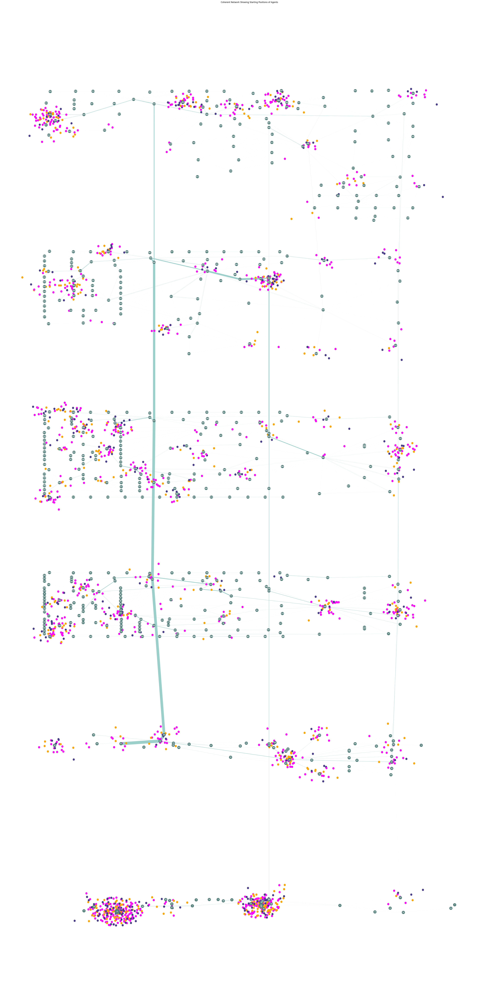

Total number of agents in CSV: 1700
Total number of unique node-agent type groups: 275


In [31]:
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np
from matplotlib.patches import Ellipse
import networkx as nx

# Read agent data from CSV
agent_df = pd.read_csv('C:\\Users\\Georgios Bekakos\\Desktop\\phase02_agent_data.csv')
agent_type_and_starting_count = agent_df.groupby(['Current Node', 'Agent Type']).size().reset_index(name='Count')

# Read edge count data
edge_count_df = pd.read_csv('C:\\Users\\Georgios Bekakos\\Desktop\\phase02_edge_count.csv')
edge_count_dict = {(row['Node1'], row['Node2']): row['Count'] for _, row in edge_count_df.iterrows()}

# Read node count data
node_count_df = pd.read_csv('C:\\Users\\Georgios Bekakos\\Desktop\\phase02_node_count.csv')
node_count_dict = node_count_df.set_index('Node')['Occupancy'].to_dict()

# Aesthetics
font_family = 'sans serif'
font_weight = 'bold'
font_size = '8'
edge_color = '#9BCFCA'
font_color = 'white'
node_col = '#55827D'
student_agent_col = 'fuchsia'
academic_agent_col = 'orange'
staff_agent_col = 'darkslateblue'

# Update edge widths based on edge_count_dict
edge_widths = [edge_count_dict.get((u, v), 1) / 50 for u, v in G_sub.edges()]

# Update node sizes based on node_count_dict
node_sizes = {node: 300 + (node_count_dict.get(node, 0) * 2) for node in G_sub.nodes()}

plt.figure(figsize=(40, 80))

nx.draw(G_sub, pos, with_labels=True,
        node_size=[node_sizes.get(node, 600) for node in G_sub.nodes()],
        node_color=node_col,
        width=edge_widths, edge_color=edge_color,
        font_family=font_family, font_size=font_size, font_weight=font_weight, font_color=font_color)

# Function to populate agent circles based on starting nodes
def plot_starting_agents():
    agent_dot_counter = 0  # Initialize counter
    for _, row in agent_type_and_starting_count.iterrows():
        node, agent_type = row['Current Node'], row['Agent Type']
        agent_col = {
            'Student': student_agent_col,
            'Academic': academic_agent_col,
            'Staff': staff_agent_col
        }.get(agent_type, 'black')

        agent_radius = 1.4
        node_radius = np.sqrt(node_sizes.get(node, 600) / np.pi)
        center_x, center_y = pos[node]

        angle = np.random.uniform(0, 2 * np.pi)
        r = np.random.uniform(0, 1.8 * node_radius)
        agent_x = center_x + r * np.cos(angle)
        agent_y = center_y + r * np.sin(angle)

        ellipse = Ellipse((agent_x, agent_y), width=agent_radius/1.2, height=agent_radius*1.6, facecolor=agent_col, edgecolor=None)
        plt.gca().add_artist(ellipse)

        agent_dot_counter += 1  # Increment the counter for each agent dot plotted

    print(f"Total number of agent dots plotted: {agent_dot_counter}")  # Display the final count

# Plot agents based on starting nodes
plot_starting_agents()


def plot_individual_agents():
    for _, row in agent_df.iterrows():
        node, agent_type = row['Current Node'], row['Agent Type']
        agent_col = {
            'Student': student_agent_col,
            'Academic': academic_agent_col,
            'Staff': staff_agent_col
        }.get(agent_type, 'black')

        agent_radius = 1.4
        node_radius = np.sqrt(node_sizes.get(node, 600) / np.pi)
        center_x, center_y = pos[node]

        angle = np.random.uniform(0, 2 * np.pi)
        r = np.random.uniform(0, 0.9 * node_radius)
        agent_x = center_x + r * np.cos(angle)
        agent_y = center_y + r * np.sin(angle)

        ellipse = Ellipse((agent_x, agent_y), width=agent_radius/1.2, height=agent_radius*1.6, facecolor=agent_col, edgecolor=None)
        plt.gca().add_artist(ellipse)


plt.title("Coherent Network Showing Starting Positions of Agents")
plt.gca().set_aspect('auto', adjustable='box')
# Plot agents individually
plot_individual_agents()

plt.show()
print(f"Total number of agents in CSV: {len(agent_df)}")
unique_groups = agent_type_and_starting_count.shape[0]
print(f"Total number of unique node-agent type groups: {unique_groups}")


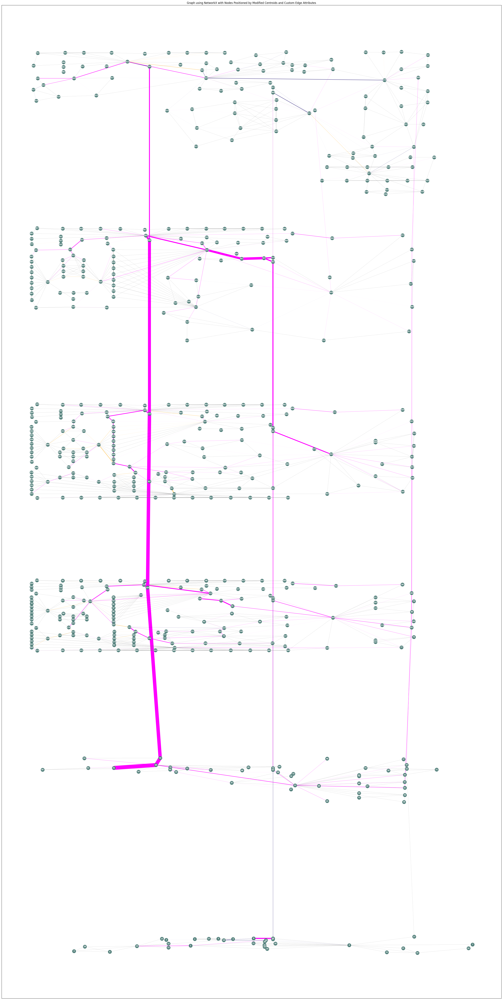

In [59]:
import os
import networkx as nx
import matplotlib.pyplot as plt
import pandas as pd
import ast

# File Paths
directory = r"C:\Users\Georgios Bekakos\Desktop"
nodes_csv = os.path.join(directory, "nodes_final.csv")
hor_edges_csv = os.path.join(directory, "edges_final.csv")
vert_edges_csv = os.path.join(directory, "edges_vertical_final.csv")
edge_count_csv = os.path.join(directory, "phase02_edge_count_with_agent_type.csv")

# Read CSVs
nodes = pd.read_csv(nodes_csv)
hor_edges = pd.read_csv(hor_edges_csv)
vert_edges = pd.read_csv(vert_edges_csv)

# Read edge count data with agent type
edge_count_df = pd.read_csv(edge_count_csv)
edge_count_df['Edge'] = edge_count_df['Edge'].apply(ast.literal_eval)  # Convert the string to tuple

# Initialize dictionaries for edge colors and edge widths
edge_colors = {}
edge_widths = {}

# Populate the dictionaries based on the CSV
for _, row in edge_count_df.iterrows():
    edge = row['Edge']
    count = row['Count']
    agent_type = row['Most Common Agent Type']
    
    # Normalize thickness for each agent type
    if agent_type == 'Student':
        thickness = count / 50  # Adjust denominator as needed
    elif agent_type == 'Academic':
        thickness = count / 20  # Adjust denominator as needed
    elif agent_type == 'Staff':
        thickness = count / 30  # Adjust denominator as needed
    else:
        thickness = 0.2
    
    # Set edge color
    color = {'Student': 'fuchsia', 'Academic': 'orange', 'Staff': 'darkslateblue'}.get(agent_type, 'black')
    
    edge_colors[edge] = color
    edge_widths[edge] = thickness

# Aesthetics
figsize_B = (40, 80)
node_col = '#55827D'
font_family = 'sans serif'
font_weight = 'bold'
font_size = 8

# Plotting with custom edge colors and widths
plt.figure(figsize=figsize_B)

# Draw edges with custom attributes
for edge in G.edges():
    color = edge_colors.get(edge, 'grey')  # Default to 'grey' if edge not in CSV
    width = edge_widths.get(edge, 0.2)  # Default to 0.2 if edge not in CSV
    nx.draw_networkx_edges(G, pos, edgelist=[edge], edge_color=color, width=width)

# Draw nodes and labels
nx.draw_networkx_nodes(G, pos, node_color=node_col, node_size=250)
nx.draw_networkx_labels(G, pos, font_size=font_size, font_color='white', font_family=font_family, font_weight=font_weight)

plt.title("Graph using NetworkX with Nodes Positioned by Modified Centroids and Custom Edge Attributes")
plt.show()

C:\Users\Georgios Bekakos\AppData\Local\Temp\ipykernel_4028\3591115918.py:95: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  cmap = cm.get_cmap('plasma')


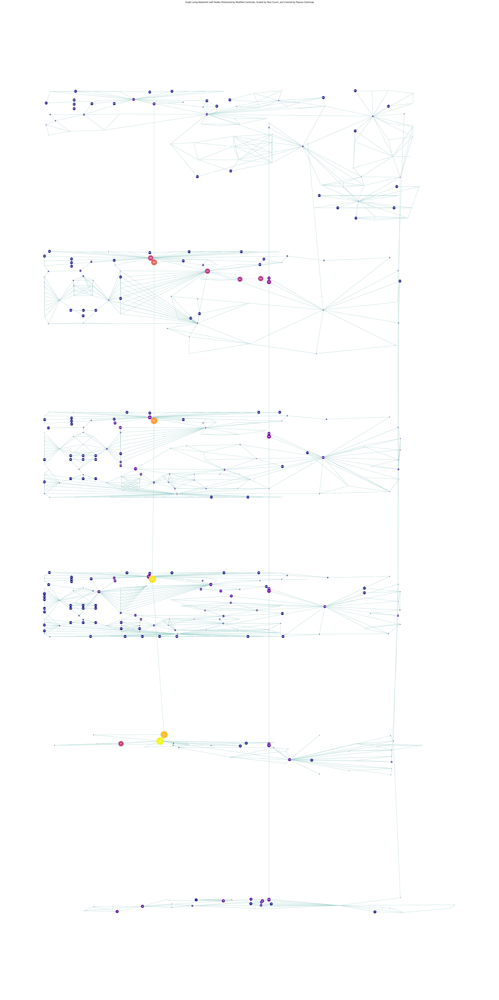

In [43]:
import csv
import os
import networkx as nx
import matplotlib.pyplot as plt
import pandas as pd
import ast  # For string-to-tuple conversion
import matplotlib.cm as cm

# Aesthetics
cmap = plt.cm.jet
cmap = cmap.reversed()
cmap.set_bad('gray')

font_family = 'sans serif'
font_weight = 'bold'
font_size = '8'
edge_color = '#9BCFCA'
font_color = 'white'
node_col = '#55827D'

highlight = '#E10686'
figsize = (30, 30)
figsize_B = (40, 80)

# File Paths
directory = r"C:\Users\Georgios Bekakos\Desktop"
nodes_csv = os.path.join(directory, "nodes_final.csv")
hor_edges_csv = os.path.join(directory, "edges_final.csv")
vert_edges_csv = os.path.join(directory, "edges_vertical_final.csv")
phase02_filepath = os.path.join(directory, "phase02_passed_node_data.csv")  # New Filepath

# Read CSVs
nodes = pd.read_csv(nodes_csv)
hor_edges = pd.read_csv(hor_edges_csv)
vert_edges = pd.read_csv(vert_edges_csv)
phase02_data = pd.read_csv(phase02_filepath)  # New DataFrame

# Rename Columns for Vertical Edges
new_column_names = {
    'Source Room Number': 'vi Room Number',
    'Target Room Number': 'vj Room Number',
    'Source Room Unique ID': 'vi Room Unique ID',
    'Target Room Unique ID': 'vj Room Unique ID'
}
vert_edges.rename(columns=new_column_names, inplace=True)

# Concatenate Edges
edges = pd.concat([hor_edges, vert_edges], ignore_index=True)

# Extract a list of levels to use as multipliers for Y coordinates
multipliers_A = list(nodes['Level'])

# Single value for multiplication
scale = 0.1
multipliers = [x * scale for x in multipliers_A]

# Convert list of strings to list of tuples
coordinates_strings = list(nodes['Centroid'])
coordinates_tuples = [(float(x), float(y)) for x, y in [coord.strip('()').split(',') for coord in coordinates_strings]]

# Multiply the y values by the corresponding multipliers
modified_coordinates = [(x, y * multiplier) for (x, y), multiplier in zip(coordinates_tuples, multipliers)]

# Create position dictionary
pos = {row['Index']: modified_coordinates[i] for i, (_, row) in enumerate(nodes.iterrows())}

# Create Graph
G = nx.Graph()
for _, row in edges.iterrows():
    source = row['vi']
    target = row['vj']
    edge_attributes = row.drop(['vi', 'vj']).fillna('None').to_dict()
    G.add_edge(source, target, **edge_attributes)

# Embed Node Info
node_attributes = {}
for _, row in nodes.iterrows():
    node_id = row['Index']
    node_attributes[node_id] = row.fillna('None').to_dict()
nx.set_node_attributes(G, node_attributes)

# Merge the new DataFrame with the original nodes DataFrame
merged_nodes = pd.merge(nodes, phase02_data, how="left", left_on="Index", right_on="Node")

# Create node sizes based on 'Pass Count'
default_size = 250
node_sizes = {row['Index']: row['Pass Count'] if not pd.isna(row['Pass Count']) else default_size for _, row in merged_nodes.iterrows()}

# Normalize the 'Pass Count' for colormap
max_pass_count = merged_nodes['Pass Count'].max()
min_pass_count = merged_nodes['Pass Count'].min()
norm_pass_count = {row['Index']: (row['Pass Count'] - min_pass_count) / (max_pass_count - min_pass_count) if not pd.isna(row['Pass Count']) else 0 for _, row in merged_nodes.iterrows()}

# Create the colormap
cmap = cm.get_cmap('plasma')

# Create node colors based on normalized 'Pass Count'
node_colors = {node: cmap(norm_pass_count[node]) for node in G.nodes()}

# Plot the graph
plt.figure(figsize=figsize_B)
nx.draw(G, pos, with_labels=True, font_family=font_family,
        font_weight=font_weight, font_size=font_size, edge_color=edge_color,
        font_color=font_color, 
        node_size=[node_sizes[node] for node in G.nodes()],
        node_color=[node_colors[node] for node in G.nodes()])
plt.title("Graph using NetworkX with Nodes Positioned by Modified Centroids, Scaled by Pass Count, and Colored by Plasma Colormap")
plt.show()


In [38]:
print(nodes.columns)
print(phase02_data.columns)


Index(['Index', 'Room Number', 'Room Name', 'Room Unique ID', 'Polygon Points',
       'Touching Wall Unique IDs', 'Area', 'Centroid', 'Level',
       'Degree Centrality', 'Closeness Centrality', 'Betweenness Centrality',
       'PageRank', 'Clustering', 'Core Number', 'Program Amplifier',
       'Initial Circulation Index', 'Circulation Index', 'Occupancy',
       'Isovist Area', 'Perimeter', 'Compactness', 'Circularity',
       'Convex Deficiency', 'Occlusivity', 'Skewness', 'Dispersion',
       'Elongation', 'Incident Radiation', 'Sunlight Hours', 'Daylight Factor',
       'Standard Effective Temperature', 'Predicted Mean Vote',
       'Comfort Acceptance', 'Subject Condition'],
      dtype='object')
Index(['Node', 'Pass Count', 'Room Name'], dtype='object')


# # FIRE

In [54]:
from mesa import Agent, Model
from mesa.time import RandomActivation
from mesa.datacollection import DataCollector
import networkx as nx
from networkx import shortest_path_length
import pandas as pd
from collections import Counter
from random import choice

# Initialize global variables and counters
G_sub = G.copy()  # Assuming G is already defined
nodes_to_avoid = {37, 206, 55, 41, 65, 69}
edge_count = Counter()

# Read the agent data from the previous simulation
prev_agent_data = pd.read_csv("C:\\Users\\Georgios Bekakos\\Desktop\\phase02_agent_data.csv")
new_starting_nodes = prev_agent_data['Current Node']

class EmergencyAgent(Agent):
    def __init__(self, unique_id, model, initial_node, agent_type):
        super().__init__(unique_id, model)
        self.initial_node = initial_node
        self.current_node = initial_node
        self.agent_type = agent_type
        self.path = [initial_node]
        
    def move(self):
        if self.current_node in nodes_to_avoid:
            neighbors = list(G_sub.neighbors(self.current_node))
            if neighbors:
                self.current_node = choice(neighbors)
                self.path.append(self.current_node)

        if self.current_node == 0:
            return
        
        neighbors = [n for n in G_sub.neighbors(self.current_node) if n not in nodes_to_avoid and G_sub.nodes[n].get('Compactness', 0) < 0.8]
        
        if not neighbors:
            return
        
        distances_to_goal = {n: shortest_path_length(G_sub, source=n, target=0) for n in neighbors}

        sorted_neighbors = sorted(neighbors, key=lambda x: distances_to_goal[x] - sum(G_sub.nodes[x].get(attr, 0) for attr in ['Degree Centrality', 'Closeness Centrality', 'Betweenness Centrality']))
        
        # Introduce some randomness for the top 3 choices
        best_neighbors = sorted_neighbors[:3] if len(sorted_neighbors) >= 3 else sorted_neighbors

        best_neighbor = choice(best_neighbors)
        
        self.current_node = best_neighbor
        self.path.append(best_neighbor)

        edge_count[(self.path[-2], self.path[-1])] += 1

class EmergencyModel(Model):
    def __init__(self, agent_data):
        self.schedule = RandomActivation(self)
        
        for index, row in agent_data.iterrows():
            agent = EmergencyAgent(row['AgentID'], self, new_starting_nodes[index], row['Agent Type'])
            self.schedule.add(agent)
        
        agent_reporters = {"Starting Node": "initial_node", "Current Node": "current_node", "Path": "path", "Agent Type": "agent_type"}
        self.datacollector = DataCollector(agent_reporters=agent_reporters)
        
    def step(self):
        for agent in self.schedule.agents:
            agent.move()  # Ensure the move method is called
            
        self.datacollector.collect(self)
        
    def run_model(self, n_steps):
        for i in range(n_steps):
            self.step()
            
    def write_data_to_csv(self):
        agent_data = self.datacollector.get_agent_vars_dataframe().reset_index()
        agent_data.to_csv("C:\\Users\\Georgios Bekakos\\Desktop\\phase03_agent_data_output.csv", index=False)

# Initialize the model and run it
model = EmergencyModel(agent_data=agent_df)
model.run_model(500)  # Run for 10 steps as an example

# Write the agent data to a CSV file
model.write_data_to_csv()

# Export edge counts to CSV
if edge_count:
    edge_df = pd.DataFrame.from_dict(edge_count, orient='index', columns=['Count']).reset_index()
    edge_df[['Node1', 'Node2']] = pd.DataFrame(edge_df['index'].apply(lambda x: list(x)).tolist(), index=edge_df.index)
    edge_df = edge_df.drop('index', axis=1)
    edge_df.to_csv("C:\\Users\\Georgios Bekakos\\Desktop\\phase03_edge_count.csv", index=False)


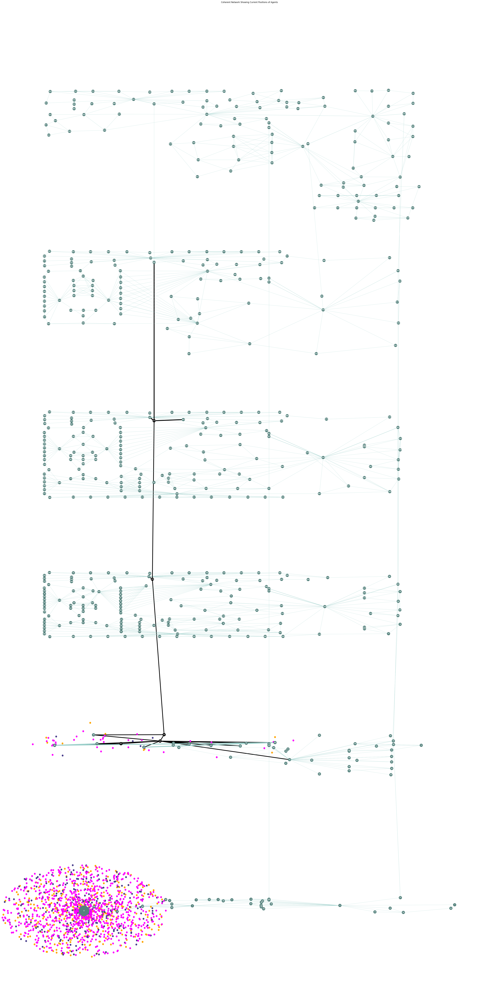

In [56]:
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np
from matplotlib.patches import Ellipse
import networkx as nx

# Read agent data from CSV
agent_df = pd.read_csv('C:\\Users\\Georgios Bekakos\\Desktop\\phase03_agent_data_output.csv')
agent_type_and_current_count = agent_df.groupby(['Current Node', 'Agent Type']).size().reset_index(name='Count')

# Read edge count data
edge_count_df = pd.read_csv('C:\\Users\\Georgios Bekakos\\Desktop\\phase03_edge_count.csv')
edge_count_dict = {(row['Node1'], row['Node2']): row['Count'] for _, row in edge_count_df.iterrows()}

# Read node count data
node_count_df = pd.read_csv('C:\\Users\\Georgios Bekakos\\Desktop\\phase03_room_data4.csv')
node_count_dict = node_count_df.set_index('Node')['Occupancy'].to_dict()

# Aesthetics
font_family = 'sans serif'
font_weight = 'bold'
font_size = '8'
font_color = 'white'
node_col = '#55827D'
student_agent_col = 'fuchsia'
academic_agent_col = 'orange'
staff_agent_col = 'darkslateblue'

# Calculate the min and max edge counts for normalization
min_edge_count = min(edge_count_dict.values())
max_edge_count = max(edge_count_dict.values())

# Define min and max widths
min_width = 0.5
max_width = 5.0

# Initialize special_nodes set
special_nodes = set()
special_edges = [(206, 55), (206, 373), (55, 69), (41, 69)]
for u, v in special_edges:
    special_nodes.add(u)
    special_nodes.add(v)

# Initialize node colors
node_colors = []
for node in G_sub.nodes():
    if node in special_nodes:
        node_colors.append('black')
    else:
        node_colors.append(node_col)

# Initialize edge colors and widths
edge_colors = []
edge_widths = []
for u, v in G_sub.edges():
    raw_width = edge_count_dict.get((u, v), 1)
    
    # Normalize the edge width
    normalized_width = min_width + (max_width - min_width) * ((raw_width - min_edge_count) / (max_edge_count - min_edge_count))
    
    if u in special_nodes or v in special_nodes:
        edge_colors.append('black')
        edge_widths.append(normalized_width * 8)  # Custom multiplier for special edges
    else:
        edge_colors.append(edge_color)
        edge_widths.append(normalized_width)

# Update node sizes based on node_count_dict
node_sizes = {node: 300 + (node_count_dict.get(node, 0) * 2) for node in G_sub.nodes()}

plt.figure(figsize=(40, 80))

nx.draw(G_sub, pos, with_labels=True,
        node_size=[node_sizes.get(node, 600) for node in G_sub.nodes()],
        node_color=node_colors,  # Use the modified node_colors
        width=edge_widths, edge_color=edge_colors,  # Use the modified edge_colors
        font_family=font_family, font_size=font_size, font_weight=font_weight, font_color=font_color)

# Function to populate agent circles based on current nodes
def plot_current_agents():
    for _, row in agent_type_and_current_count.iterrows():
        node, agent_type, agents = row['Current Node'], row['Agent Type'], row['Count']
        agent_col = {
            'Student': student_agent_col,
            'Academic': academic_agent_col,
            'Staff': staff_agent_col
        }.get(agent_type, 'black')

        if agents > 0:
            agent_radius = 1.2
            node_radius = np.sqrt(node_sizes.get(node, 600) / np.pi)
            center_x, center_y = pos[node]

            for _ in range(agents):
                angle = np.random.uniform(0, 2 * np.pi)
                r = np.random.uniform(0, 1.4 * node_radius)
                agent_x = center_x + r * np.cos(angle)
                agent_y = center_y + r * np.sin(angle)

                ellipse = Ellipse((agent_x, agent_y), width=agent_radius/1.2, height=agent_radius*1.6, facecolor=agent_col, edgecolor=None)
                plt.gca().add_artist(ellipse)

# Plot agents based on current nodes
plot_current_agents()

plt.title("Coherent Network Showing Current Positions of Agents")
plt.gca().set_aspect('auto', adjustable='box')

plt.show()


# # SPIDERPLOTS

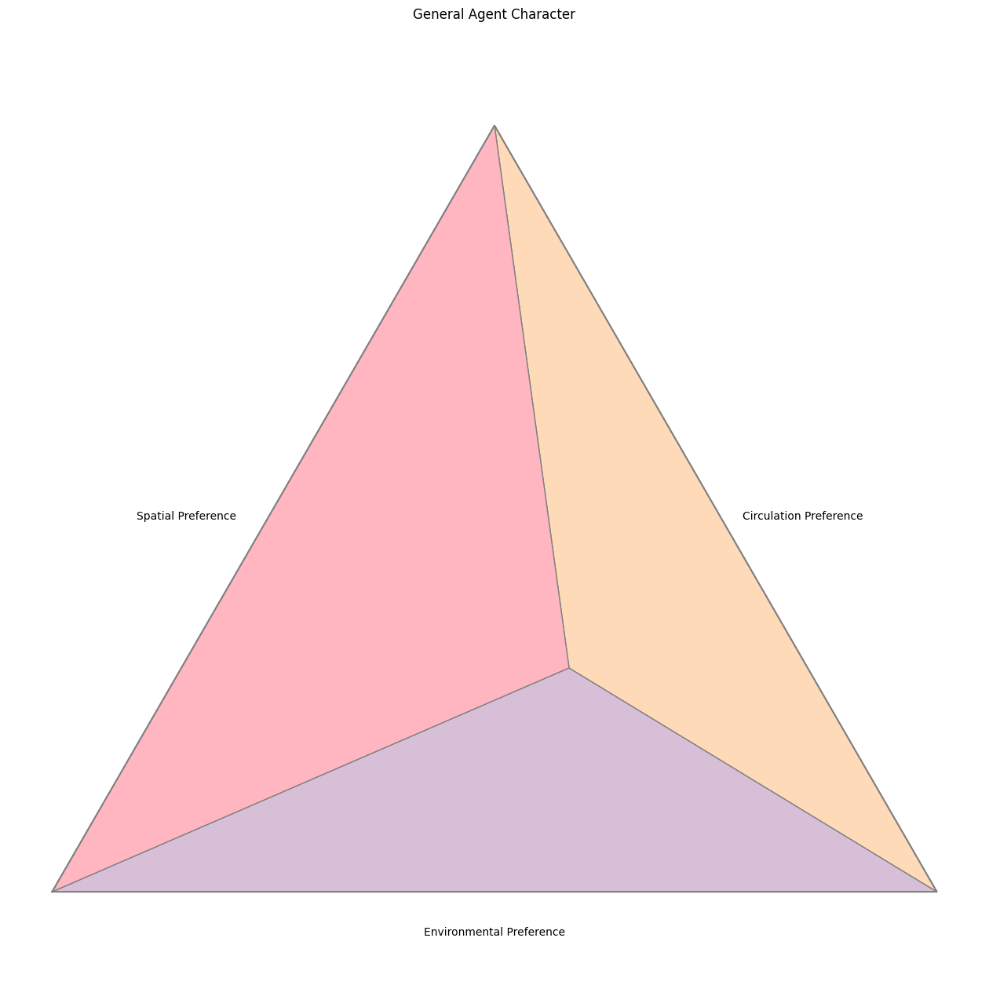

In [88]:
import matplotlib.pyplot as plt
import pandas as pd
import random
import numpy as np
import os

# Create output directory
output_dir = 'c:\\Users\\Georgios Bekakos\\Desktop\\AGENT CHARACTERS PLOTS'
if not os.path.exists(output_dir):
    os.makedirs(output_dir)

# Read CSV file and pick a random row
df_new = pd.read_csv('c:\\Users\\Georgios Bekakos\\Desktop\\agents_characters.csv')
row_index = random.randint(0, len(df_new) - 1)
row_data = df_new.iloc[row_index]

# Create a triangular plot for General Agent Character
def create_triangular_plot(title, labels, values, color):
    fig, ax = plt.subplots(figsize=(16, 16))
    ax.axis('equal')  # Equal aspect ratio
    
    # Coordinates for the triangle vertices
    x = np.array([0, 1, 0.5])
    y = np.array([0, 0, np.sqrt(3)/2])
    
    # Plot the triangle
    ax.plot(np.append(x, x[0]), np.append(y, y[0]), color='grey')
    
    # Find coordinates for the data points inside the triangle
    p1 = np.array([x[0], y[0]])
    p2 = np.array([x[1], y[1]])
    p3 = np.array([x[2], y[2]])
    
    inner_point = values[0]*p1 + values[1]*p2 + values[2]*p3
    inner_point /= np.sum(values)
    
    # Color minor triangles
    minor_triangles = [(p1, p2, inner_point), (p2, p3, inner_point), (p3, p1, inner_point)]
    colors = ['thistle', 'peachpuff', 'lightpink']
    for vertices, color in zip(minor_triangles, colors):
        triangle = plt.Polygon(vertices, edgecolor='grey', facecolor=color)
        ax.add_patch(triangle)
    
    # Calculate midpoints for labels
    midpoints = [(p1 + p2)/2, (p2 + p3)/2, (p3 + p1)/2]
    offsets = [(0, -40), (80, -10), (-80, -10)]
    
    # Annotate the midpoints of the triangle sides with the labels
    for i, txt in enumerate(labels):
        ax.annotate(txt, midpoints[i], textcoords="offset points", xytext=offsets[i], ha='center')
    
    ax.set_title(title)
    ax.axis('off')
    
    plt.savefig(os.path.join(output_dir, f"{title}.png"))
    plt.show()

labels_and_colors = [('General Agent Character', ['Environmental Preference', 'Circulation Preference', 'Spatial Preference'], 'red')]

for title, labels, color in labels_and_colors:
    values = [row_data[col] for col in labels if col in df_new.columns]
    if len(values) == len(labels):
        create_triangular_plot(title, labels, values, color)


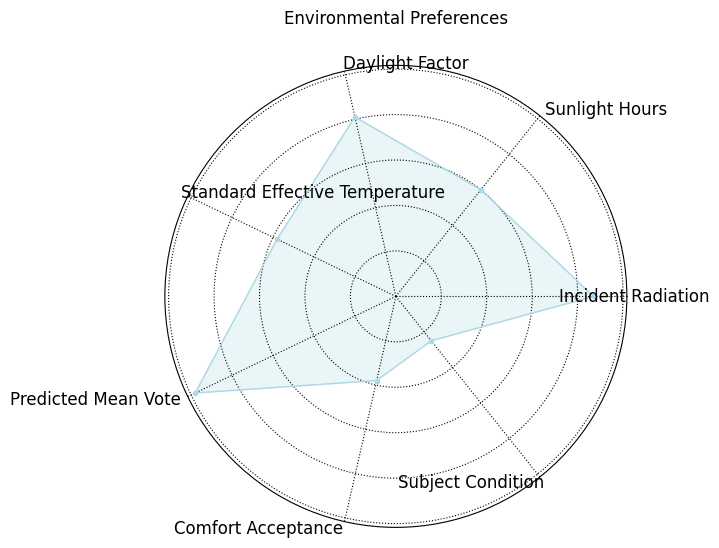

In [97]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import random

# Function to create a spider plot with labels just outside the plot area but not crossing it, and different colors
def create_spider_plot_with_precise_labels(title, labels, values, color):
    num_vars = len(values)
    angles = np.linspace(0, 2 * np.pi, num_vars, endpoint=False).tolist()

    values += values[:1]
    angles += angles[:1]

    fig, ax = plt.subplots(figsize=(6, 6), subplot_kw=dict(polar=True))
    ax.fill(angles, values, color=color, alpha=0.25)
    ax.plot(angles, values, color=color, linewidth=1, linestyle='solid', marker='o', markersize=3)

    ax.set_title(title, color='black', pad=30, loc='center', fontsize=12)
    ax.set_xticks(angles[:-1])
    ax.set_xticklabels([])
    ax.set_yticklabels([])
    ax.grid(linestyle='dotted', color='black')

    for angle, label in zip(angles, labels):
        ha = 'center' if angle in [0, np.pi] else ('left' if 0 < angle < np.pi else 'right')
        ax.text(angle, 1.05, label, size=12, horizontalalignment=ha, verticalalignment="center")

    plt.show()

# Read CSV file and pick a random row
file_path = 'C:\\Users\\Georgios Bekakos\\Desktop\\agents_characters.csv'
df_new = pd.read_csv(file_path)
row_index = random.randint(0, len(df_new) - 1)
row_data = df_new.iloc[row_index]

labels_and_colors = [
    ('Circulation Preferences', ['Normalized Degree Centrality', 'Normalized Closeness Centrality', 'Normalized Betweenness Centrality', 'Normalized PageRank', 'Normalized Clustering', 'Normalized Core Number', 'Normalized Circulation Index'], 'coral'),
    ('Spatial Preferences', ['Normalized Isovist Area', 'Normalized Perimeter', 'Normalized Compactness', 'Normalized Circularity', 'Normalized Convex Deficiency', 'Normalized Occlusivity', 'Normalized Skewness', 'Normalized Dispersion', 'Normalized Elongation'], 'lightgreen'),
    ('Environmental Preferences', ['Target Normalized Incident Radiation', 'Target Normalized Sunlight Hours', 'Target Normalized Daylight Factor', 'Target Normalized Standard Effective Temperature', 'Target Normalized Predicted Mean Vote', 'Target Normalized Comfort Acceptance', 'Target Normalized Subject Condition'], 'lightblue')
]

# Generate plots for each type of preference
for title, labels, color in labels_and_colors:
    clean_labels = [label.replace('Target ', '').replace('Normalized ', '') for label in labels]
    values = [row_data[col] for col in labels if col in df_new.columns]
    
    if len(values) == len(labels):
        create_spider_plot_with_precise_labels(title, clean_labels, values, color)
